In [500]:
import yaml
import os
from gblock.functions import print_function, load_yaml
import numpy as np
from keras.datasets import mnist, cifar10
from sklearn.model_selection import train_test_split
import pprint
import tensorflow as tf
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, Dropout, Concatenate, AveragePooling2D, Flatten, Dense, BatchNormalization, SpatialDropout2D, GlobalAveragePooling2D
from keras.utils.vis_utils import plot_model
from copy import deepcopy
from data_preprocessing.data_loader import *
import logging


# Move the load data function to the functions.py file
# You should be able to pass in any dataset you want to run the model on
# Separation between data -> block GA -> model GA
# Very basic model can be used to solve Gibbon data
# Idea is to produce unique, high performing blocks that can potentially be genralised to any image dataset
# Or at the very least have a surrogate to dictate the best blocks for a given dataset



class BlockNEAT:

    def __init__(self, parameter_path):

        print('BlockNEAT')
        
        self.parameters = load_yaml(parameter_path)

        self.general_parameters = self.parameters['general']

        self.data_parameters = self.parameters['data']

        self.model_parameters = self.parameters['model']

        self.neat_parameters = self.parameters['neat']

        if self.general_parameters['seed_value'] != None:
            np.random.seed(self.general_parameters['seed_value'])



    def load_data(self, use_case = None, **kwargs):

        """
        Load predefined use case data for the model
        """

        print('BlockNEAT.load_data')

        print('Loading data for use case: {}'.format(use_case))

        possible_use_cases = ['mnist', 'cifar10', 'cifar100', 'gibbon']

        if use_case == None or use_case not in possible_use_cases:
            raise ValueError('Please specify a valid use case from the following: {} or supply own data to model'.format(possible_use_cases))
        
        elif use_case == 'mnist':

            (X_train, Y_train), (X_test, Y_test) = load_mnist_data()

        elif use_case == 'cifar10':

            (X_train, Y_train), (X_test, Y_test) = load_cifar10_data()

        elif use_case == 'cifar100':

            (X_train, Y_train), (X_test, Y_test) = load_cifar100_data()

        elif use_case == 'gibbon':

            if len(kwargs) > 0:

                try:
                    (X_train, Y_train), (X_test, Y_test) = load_gibbon_data(**kwargs)

                except ValueError as e:
                    print(e)
            else:
                (X_train, Y_train), (X_test, Y_test) = load_gibbon_data()

        return (X_train, Y_train), (X_test, Y_test)
    

    
    
    def generate_initial_population(self, path_to_minimal_individual, population_size = None):

        """
        Generate the minimal structure population for the blocks        
        """

        print('BlockNEAT.generate_initial_population')

        if self.neat_parameters['block']['population_size'] != None:
            self.population_size = self.neat_parameters['block']['population_size']

        elif population_size != None:
            self.population_size = population_size

        else:
            raise ValueError('Please specify a population size for the blocks')

        population = {}

        minimal_individual = load_yaml(path_to_minimal_individual)

        minimal_individual['meta_data']['connections'][0] = tuple(minimal_individual['meta_data']['connections'][0])

        for i in range(self.population_size):

            population['individual_' + str(i + 1)] = minimal_individual

        nodes = list(minimal_individual['nodes'].keys())

        connections = [('node_input', 'node_output', 'connection_1')]

        self.nodes = nodes
        self.connections = connections

        print('Generating initial population of size {} given the minimal structure at path {}.'.format(self.population_size, path_to_minimal_individual))
        
        return population #, nodes, connections
    


    def mutation_selection(self, population, mutation_rate = 0.01):

        """
        Select the individuals to be mutated
        """

        print('BlockNEAT.mutation_selection')

        individuals = list(population.keys())

        mutate_index = np.where(np.random.random(self.population_size) < mutation_rate)[0]

        print('Mutation selection: Mutating the following individuals: {}'.format(individuals[mutate_index]))

        return individuals[mutate_index]
    


    def define_new_node(self):

        """
        Add a new node to the individual
        """

        print('BlockNEAT.mutation_selection.mutate_add_node.define_new_node')

        # Select a random layer to add the node to
        layer_type = np.random.choice(list(self.model_parameters.keys())) # Think about using probability distribution for conv, pool, dropout (p =[0.8, 0.1, 0.1])

        # define the new node
        if layer_type == 'convolution':
            kernel = np.random.choice(self.model_parameters['convolution']['kernel'])
            filter = np.random.choice(self.model_parameters['convolution']['filter'])
            padding = np.random.choice(self.model_parameters['convolution']['padding'])
            node_attr = {'kernel':kernel, 'filter':filter, 'padding':padding}
            try:
                node_id = 'node_c' + str(max([int(item.replace('node_c', '')) for item in self.nodes if 'node_c' in item]) + 1)
            except:
                node_id = 'node_c1'


        elif layer_type == 'pooling':
            pool_type = np.random.choice(self.model_parameters['pooling']['type'])
            size = np.random.choice(self.model_parameters['pooling']['size'])
            node_attr = {'type':pool_type, 'size':size, 'padding':'same'}
            try:
                node_id = 'node_p' + pool_type[0] + str(max([int(item.replace('node_p' + pool_type[0], '')) for item in self.nodes if 'node_p' + pool_type[0] in item]) + 1)
            except:
                node_id = 'node_p' + pool_type[0] + '1'


        elif layer_type == 'dropout':
            dropout_rate = np.round(np.random.random()*(np.max(self.model_parameters['dropout']['rate']) - np.min(self.model_parameters['dropout']['rate'])) + np.min(self.model_parameters['dropout']['rate']), 2)
            node_attr = {'rate':dropout_rate}
            try:
                node_id = 'node_d' + str(max([int(item.replace('node_d', '')) for item in self.nodes if 'node_d' in item]) + 1)
            except:
                node_id = 'node_d1'

        else:
            raise ValueError('Layer type not recognised')
        
        print('Define new node: adding a new node of type {} with attributes {} and id {}'.format(layer_type, node_attr, node_id))

        return node_attr, layer_type, node_id
    

    
    def get_innovation_number(self, node_in_connection, node_out_connection):

        """
        Determine the innovation number and name for a connection
        """

        print('BlockNEAT.mutation_selection.get_innovation_number')

        if (node_in_connection, node_out_connection) not in [nodes[0:-1] for nodes in self.connections]:
            innovation_number = len(self.connections) + 1
            innovation_type = 'new'
            

        else:
            innovation_number = [i for i in range(len(self.connections)) if self.connections[i][0:-1] == (node_in_connection, node_out_connection)][0] + 1
            innovation_type = 'existing'

        connection_name = f'connection_{innovation_number}'

        print('Innovation number: Connection {} between nodes {} and {} has innovation number {} and is a {} connection.'.format(connection_name, node_in_connection, node_out_connection, innovation_number, innovation_type))

        return innovation_number, connection_name, innovation_type
    
    

    def update_nodes_local(self, individual):

        """
        For each node, update the local information (immediate connections)
        """

        print('BlockNEAT.mutation_selection.update_nodes_local')

        # Make a copy of the individual
        individual_copy = deepcopy(individual)

        connections = list(individual_copy['connections'].keys())

        nodes = list(individual_copy['nodes'].keys())

        for node in nodes:

            print('Updating local information for node {}'.format(node))

            individual_copy['nodes'][node]['connections_in'] = []
            individual_copy['nodes'][node]['connections_in_enabled'] = []
            individual_copy['nodes'][node]['nodes_in'] = []
            individual_copy['nodes'][node]['n_connections_in'] = 0


            individual_copy['nodes'][node]['connections_out'] = []
            individual_copy['nodes'][node]['connections_out_enabled'] = []
            individual_copy['nodes'][node]['nodes_out'] = []
            individual_copy['nodes'][node]['n_connections_out'] = 0

            for conn in connections:

                print('Updating local information for connection {}'.format(conn))

                if individual_copy['connections'][conn]['out'] == node:

                    individual_copy['nodes'][node]['connections_in'].append(conn)
                    individual_copy['nodes'][node]['connections_in_enabled'].append(individual_copy['connections'][conn]['enabled'])
                    individual_copy['nodes'][node]['nodes_in'].append(individual_copy['connections'][conn]['in'])
                    individual_copy['nodes'][node]['n_connections_in'] += 1

                elif individual_copy['connections'][conn]['in'] == node:

                    individual_copy['nodes'][node]['connections_out'].append(conn)
                    individual_copy['nodes'][node]['connections_out_enabled'].append(individual_copy['connections'][conn]['enabled'])
                    individual_copy['nodes'][node]['nodes_out'].append(individual_copy['connections'][conn]['out'])
                    individual_copy['nodes'][node]['n_connections_out'] += 1

        return individual_copy
    

    
    def depth_first_search(self, individual, node, visited = [], connected_nodes = [], direction = 'forward'): 
        """
        Depth first search algorithm follows the path of enabled connections from a source node.
        If direction = 'forward', the algorithm follows all output connections and nodes until it reaches the output or a node with no output connections.
        Conversely, if direction = 'backward', the algorithm follows all input connections and nodes until it reaches the input or a node with no input connections.
        The algorithm returns a list of all nodes visited on the path.
        """

        print('BlockNEAT.mutation_selection.update_nodes_global.depth_first_search')

        if direction == 'forward':
            conn_dir = 'connections_out_enabled'
            node_dir = 'nodes_out'

        elif direction == 'backward':
            conn_dir = 'connections_in_enabled'
            node_dir = 'nodes_in'

        else:
            raise ValueError('Direction must be either forward or backward')
        
        if node not in visited:

            print('Depth first search: visiting node {}'.format(node))
            
            visited.append(node)
        
            for neighbour in np.array(individual['nodes'][node][node_dir])[individual['nodes'][node][conn_dir]]:

                print('Depth first search: visiting neighbouring node {}'.format(neighbour))
                
                connected_nodes.append(neighbour)
                
                self.depth_first_search(individual, neighbour, visited, connected_nodes, direction)

        return list(set(connected_nodes))
    
    

    def update_nodes_global(self, individual):

        """
        For each node, update the global information (all connections)
        """

        print('BlockNEAT.mutation_selection.update_nodes_global')

        # Make a copy of the individual
        individual_copy = deepcopy(individual)

        nodes = list(individual_copy['nodes'].keys())

        for node in nodes:

            print('Updating global information for node {}'.format(node))

            individual_copy['nodes'][node]['preceding_nodes'] = self.depth_first_search(individual_copy, node, visited = [], connected_nodes = [], direction = 'backward')
            individual_copy['nodes'][node]['following_nodes'] = self.depth_first_search(individual_copy, node, visited = [], connected_nodes = [], direction = 'forward')

            if len(individual_copy['nodes'][node]['following_nodes']) > 0 or node == 'node_output':
                individual_copy['nodes'][node]['connectedness'] = len(individual_copy['nodes'][node]['preceding_nodes']) / (len(individual_copy['nodes'])  - 1)

            else:
                individual_copy['nodes'][node]['connectedness'] = 0 

        return individual_copy
    

    
    def update_meta_data(self, individual):

        """
        Update the meta data for the individual
        """

        print('BlockNEAT.mutation_selection.update_meta_data')

        # Make a copy of the individual
        individual_copy = deepcopy(individual)

        individual_copy['meta_data']['connections'] = []
        individual_copy['meta_data']['connections_enabled'] = []
        individual_copy['meta_data']['n_convolution'] = 0
        individual_copy['meta_data']['n_pooling'] = 0
        individual_copy['meta_data']['n_dropout'] = 0

        for conn in individual_copy['connections']:

            print('Updating meta data for connection {}'.format(conn))

            individual_copy['meta_data']['connections'].append((individual_copy['connections'][conn]['in'], individual_copy['connections'][conn]['out'], conn))
            individual_copy['meta_data']['connections_enabled'].append(individual_copy['connections'][conn]['enabled'])


        for node in individual_copy['nodes']:

            print('Updating meta data for node {}'.format(node))

            if individual_copy['nodes'][node]['type'] == 'convolution':
                individual_copy['meta_data']['n_convolution'] += 1

            elif individual_copy['nodes'][node]['type'] == 'pooling':
                individual_copy['meta_data']['n_pooling'] += 1

            elif individual_copy['nodes'][node]['type'] == 'dropout':
                individual_copy['meta_data']['n_dropout'] += 1
        
        individual_copy['meta_data']['n_nodes'] = len(individual_copy['nodes'])
        individual_copy['meta_data']['n_connections'] = len(individual_copy['connections'])
        individual_copy['meta_data']['n_enabled'] = sum(individual_copy['meta_data']['connections_enabled'])
        individual_copy['meta_data']['node_list'] = list(individual_copy['nodes'].keys())

        return individual_copy
    
    
    def mutate_add_node(self, individual):

        """
        Add a new node to the individual
        """

        print('BlockNEAT.mutation_selection.mutate_add_node')

        # Make a copy of the individual
        individual_copy = deepcopy(individual)

        # Select a random layer to add the node to
        node_attr, layer_type, node_id = self.define_new_node()

        # Get random connection to split using the node
        split_connection = np.random.choice(list(individual_copy['connections'].keys()))

        print('Node mutate: splitting {}'.format(split_connection))

        # The nodes that are connected by the addition of the new node for innovation number tracking
        node_in = individual_copy['connections'][split_connection]['in']
        node_out = individual_copy['connections'][split_connection]['out']

        print('Node mutate: adding node {} between {} and {}'.format(node_id, node_in, node_out))

        # Get the innovation numbers for the two connections formed by the addition of the new node
        innovation_number_in, connection_name_in, innovation_type_in = self.get_innovation_number(node_in, node_id)

        if innovation_type_in == 'new':
            self.connections.append((node_in, node_id)  + (connection_name_in,))

        innovation_number_out, connection_name_out, innovation_type_out = self.get_innovation_number(node_id, node_out)

        if innovation_type_out == 'new':
            self.connections.append((node_id, node_out) + (connection_name_out,))

        if node_id not in self.nodes:
            self.nodes.append(node_id)

        # Delete the split connection
        del individual_copy['connections'][split_connection]


        # Update the connection in information
        individual_copy['connections'][connection_name_in] = {
                                                                'in':node_in, 
                                                                'out':node_id,
                                                                'enabled':True, 
                                                                'innovation':innovation_number_in
        }
        
        # Update the connection out information
        individual_copy['connections'][connection_name_out] = {
                                                                'in':node_id, 
                                                                'out':node_out,
                                                                'enabled':True, 
                                                                'innovation':innovation_number_out
        }
        
        # Update the new node information
        individual_copy['nodes'][node_id] = {
                                            'type':layer_type,
                                            'attributes':node_attr,
                                            'n_connections_in':1,
                                            'connections_in':[connection_name_in],
                                            'connections_in_enabled':[True],
                                            'nodes_in':[node_in],
                                            'preceding_nodes':[],
                                            'n_connections_out':1,
                                            'connections_out':[connection_name_out],
                                            'connections_out_enabled':[True],
                                            'nodes_out':[node_out],
                                            'following_nodes':[],
                                            'connectedness':0
        }

        self.individual_copy_updated = individual_copy

        
        print('Node mutate: updating local information for individual')
        
        # Update local information for all nodes
        individual_copy = self.update_nodes_local(individual_copy)

        self.individual_copy_local = individual_copy

        print('Node mutate: updating global information for individual')

        # Update global information for all nodes
        individual_copy = self.update_nodes_global(individual_copy)

        print('Node mutate: updating meta data for individual')

        # Update meta data
        individual_copy = self.update_meta_data(individual_copy)

        return individual_copy
    


    def mutate_add_connection(self, individual):

        """
        Add a new connection to the individual
        """

        print('BlockNEAT.mutation_selection.mutate_add_connection')

        # Make a copy of the individual
        individual_copy = deepcopy(individual)

        nodes = individual_copy['meta_data']['node_list']

        # Exclude output node in possible nodes for input to connection
        possible_nodes_in = [node for node in nodes if node != 'node_output']

        # Select a random node going into connection
        node_in = np.random.choice(possible_nodes_in) # maybe look at adding a probablistic bias to this based on relative depth/connectedness


        # Compile node exclusion list and then determine possible nodes that can be used for output connection
        # Node exclude list inlcudes: 
        # - input node (no inputs allowed), 
        # - node_in (no recursion on itself), 
        # - nodes_out of node_in (already connected to), 
        # - preceding nodes of node_in (no recursion on preceding nodes)
        excluded_nodes = ['node_input'] + [node_in] + individual_copy['nodes'][node_in]['nodes_out'] + individual_copy['nodes'][node_in]['preceding_nodes']
        possible_nodes_out = [node for node in nodes if node not in excluded_nodes]

        
        # If no possible nodes out, continue to next individual
        if len(possible_nodes_out) == 0:
            return None

        # Select a random node out
        else:

            node_out = np.random.choice(possible_nodes_out)

            print('Connection mutate: adding connection between {} and {}'.format(node_in, node_out))

            # Get the innovation numbers for the two connections formed by the addition of the new node
            innovation_number, connection_name, innovation_type = self.get_innovation_number(node_in, node_out)


            if innovation_type == 'new':
                self.connections.append((node_in, node_out)  + (connection_name,))


            # Update the connection in information
            individual_copy['connections'][connection_name] = {
                                                                    'in':node_in, 
                                                                    'out':node_out,
                                                                    'enabled':True, 
                                                                    'innovation':innovation_number
            }


            print('Connection mutate: updating local information for individual')
            
            # Update local information for all nodes
            individual_copy = self.update_nodes_local(individual_copy)

            print('Connection mutate: updating global information for individual')

            # Update global information for all nodes
            individual_copy = self.update_nodes_global(individual_copy)

            print('Connection mutate: updating meta data for individual')

            # Update meta data
            individual_copy = self.update_meta_data(individual_copy)

            return individual_copy
        
    

    def check_continuity(self, individual):

        """
        Check if the individual is continuous
        """

        following_nodes = individual['nodes']['node_input']['following_nodes']
        preceding_nodes = individual['nodes']['node_output']['preceding_nodes']

        if 'node_output' in following_nodes and 'node_input' in preceding_nodes:
            return True

        else:
            return False
        

    
    def mutate_switch_connection(self, individual):

        """
        Switch the enabled/disabled status of a random connection
        """

        print('BlockNEAT.mutation_selection.mutate_switch_connection')

        # Make a copy of the individual
        individual_copy = deepcopy(individual)

        # Get list of connections
        connections = list(individual_copy['connections'].keys())

        # Select a random connection
        switch_connection = np.random.choice(connections)

        # Get nodes connected by the connection
        node_in = individual_copy['connections'][switch_connection]['in']
        node_out = individual_copy['connections'][switch_connection]['out']

        print('Switch mutate: switching connection {} between {} and {}'.format(switch_connection, node_in, node_out))

        # Switch the enabled/disabled status of the connection
        switch_value = not individual_copy['connections'][switch_connection]['enabled']
        individual_copy['connections'][switch_connection]['enabled'] = switch_value
        individual_copy['nodes'][node_in]['connections_out_enabled'][individual_copy['nodes'][node_in]['connections_out'].index(switch_connection)] = switch_value
        individual_copy['nodes'][node_out]['connections_in_enabled'][individual_copy['nodes'][node_out]['connections_in'].index(switch_connection)] = switch_value
        individual_copy['meta_data']['connections_enabled'][individual_copy['meta_data']['connections'].index((node_in, node_out, switch_connection))] = switch_value
            
        print('Switch mutate: updating local information for individual')
        
        # Update local information for all nodes
        individual_copy = self.update_nodes_local(individual_copy)

        print('Switch mutate: updating global information for individual')

        # Update global information for all nodes
        individual_copy = self.update_nodes_global(individual_copy)

        print('Switch mutate: updating meta data for individual')

        # Update meta data
        individual_copy = self.update_meta_data(individual_copy)

        # Check if the individual is continuous
        if self.check_continuity(individual_copy):

            print('Switch mutate: individual is continuous')

            return individual_copy
        
        else:

            print('Switch mutate: individual is not continuous')
            
            return None
        

    def crossover(self, parents):

        """
        Crossover two or more parents to produce an offspring
        """

        print('BlockNEAT.crossover_selection.crossover')

        offspring = load_yaml('/Users/Donovan/Documents/Masters/masters-ed02/clean_code/gblock/minimal_individual_structure.yaml')

        offspring['connections'] = {}

        # Get all innovations/connections and all unique innovations/connections given the parent list
        all_innovations = []
        all_fitnesses = []

        for parent in parents:

            all_fitnesses.append(parent['scores']['fitness'])

            for connection in list(parent['connections'].keys()):

                all_innovations.append(connection)
        
        all_innovations_set = list(set(all_innovations))

        print('Crossover: all innovations: {}'.format(all_innovations))

        # Loop through all unique innovations
        for innovation in all_innovations_set:

            print('Crossover: innovation: {}'.format(innovation))

            # Count the number of times the innovation appears in all innovations
            n_occurances = len([inno for inno in all_innovations if inno == innovation])

            print('Crossover: number of occurances: {} and length of parents {}'.format(n_occurances, len(parents)))
            
            # Check if the number of appearances match the number of parents or if the fitnesses are all the same
            if n_occurances == len(parents) or len(set(all_fitnesses)) == 1:

                # If the innovation exists in all parents then randomly select a parent to inherit the connection from
                gene_parent = np.random.choice(parents)

            # If the innovation does not appear in all parents, select the parent with the highest fitness
            else:
                max_fitness = 0
                for parent in parents:
                    if parent['scores']['fitness'] >= max_fitness:
                        max_fitness = parent['scores']['fitness']
                        gene_parent = parent

            print('Crossover: gene parent: {}'.format(gene_parent))

            
            # Inherit the connection from the selected parent

            try:
                
                inherit_connection = gene_parent['connections'][innovation]
                offspring['connections'][innovation] = inherit_connection

                # Get node in and out of connection
                node_in = inherit_connection['in']
                node_out = inherit_connection['out']

                # Get the node information
                offspring['nodes'][node_in] = gene_parent['nodes'][node_in]
                offspring['nodes'][node_out] = gene_parent['nodes'][node_out]

                # print('Crossover: inherited connection {} from parent'.format(innovation))
                
            # If there is no connection to inherit (no corresponding innovation), then skip to the next innovation, i.e. inherit nothing
            except Exception as e:
                print(e)

                print('Crossover: no connection to inherit. Continuing to next innovation')
                continue

        pprint.pprint(offspring)

        # Update local information for all nodes
        offspring = self.update_nodes_local(offspring)

        # Update global information for all nodes
        offspring = self.update_nodes_global(offspring)

        # Update meta data
        offspring = self.update_meta_data(offspring)

        # Check if the individual is continuous
        if self.check_continuity(offspring):
            return offspring
        
        else:
            return None
        


    def build_layers(self, individual, inputs):

        """
        Define each layer/node in an individual/block given a set of attricutes for each.
        """

        print('BlockNEAT.build_layers')

        # Make a copy of the individual
        individual_copy = deepcopy(individual)

         # Loop through all nodes
        for node in individual_copy['nodes']:

            # If the layer already exists, then skip the node
            try:
                individual_copy['nodes'][node]['layer']

            # If the layer does not exist, then define the layer
            except:
                    
                # If the node is the input node, then set the layer equal to the inputs
                if node == 'node_input':

                    individual_copy['nodes'][node]['attributes']['layer_object'] = inputs
                    individual_copy['nodes'][node]['layer'] = inputs
                    individual_copy['nodes'][node]['concat_list'] = []
                    individual_copy['nodes'][node]['concat_list_names'] = []

                # If the node is the output node, then set the layer equal to None since it is defined by the previous incoming layer(s)
                elif node == 'node_output':
                    individual_copy['nodes'][node]['layer'] = None
                    individual_copy['nodes'][node]['concat_list'] = []
                    individual_copy['nodes'][node]['concat_list_names'] = []

                # If the node is anything other than the input node or the output node

                    # If the node is a convolution node
                elif individual_copy['nodes'][node]['type'] == 'convolution':

                    # Get the attributes of the convolution node
                    filters = individual_copy['nodes'][node]['attributes']['filter']
                    kernel = (individual_copy['nodes'][node]['attributes']['kernel'], individual_copy['nodes'][node]['attributes']['kernel'])
                    padding = individual_copy['nodes'][node]['attributes']['padding']

                    # Set the layer to a convolution layer
                    individual_copy['nodes'][node]['attributes']['layer_object'] = Conv2D(filters = filters, kernel_size = kernel, padding = padding, name = node) 

                    # Functional layer is empty
                    individual_copy['nodes'][node]['layer'] = None
                    individual_copy['nodes'][node]['concat_list'] = []
                    individual_copy['nodes'][node]['concat_list_names'] = []

                # If the node is a pooling node
                elif individual_copy['nodes'][node]['type'] == 'pooling':

                    # Get the attributes of the pooling node
                    pool_size = (individual_copy['nodes'][node]['attributes']['size'], individual_copy['nodes'][node]['attributes']['size'])
                    pool_type = individual_copy['nodes'][node]['attributes']['type']
                    padding = individual_copy['nodes'][node]['attributes']['padding']

                    # Set the layer to a pooling layer
                    if pool_type == 'max':
                        individual_copy['nodes'][node]['attributes']['layer_object'] = MaxPooling2D(pool_size = pool_size, strides=(1, 1), padding = padding, name = node)

                    elif pool_type == 'average':
                        individual_copy['nodes'][node]['attributes']['layer_object'] = AveragePooling2D(pool_size = pool_size, strides=(1, 1), padding = padding, name = node)

                    else:
                        raise Exception('Invalid pooling type')
                    
                    # Functional layer is empty
                    individual_copy['nodes'][node]['layer'] = None
                    individual_copy['nodes'][node]['concat_list'] = []
                    individual_copy['nodes'][node]['concat_list_names'] = []

                # If the node is a dropout node
                elif individual_copy['nodes'][node]['type'] == 'dropout':

                    # Get the attributes of the dropout node
                    rate = individual_copy['nodes'][node]['attributes']['rate']

                    # Set the layer to a dropout layer
                    individual_copy['nodes'][node]['attributes']['layer_object'] = SpatialDropout2D(rate = rate, name = node)

                    # Functional layer is empty
                    individual_copy['nodes'][node]['layer'] = None
                    individual_copy['nodes'][node]['concat_list'] = []
                    individual_copy['nodes'][node]['concat_list_names'] = []

                else:
                    raise Exception('Invalid node type')
                
        return individual_copy
    

    def valid_nodes(self, individual):

        """
        Return a list of nodes that are valid to be defined, the nodes that form part of a continuous connection between input and output.
        """

        valid_nodes = ['node_input', 'node_output']

        for node in list(individual['nodes'].keys()):

            if 'node_input' in individual['nodes'][node]['preceding_nodes'] and 'node_output' in individual['nodes'][node]['following_nodes']:

                valid_nodes.append(node)

        return valid_nodes
    


    def build_block(self, individual, node = 'node_input', valid_nodes = None, visited_nodes = []):

        """
        Build a block given a set of attributes for each node.
        """

        print('BlockNEAT.build_block')



        if valid_nodes == None:
            
            # Make a copy of the individual
            individual = deepcopy(individual)

            # Get the valid nodes
            valid_nodes = self.valid_nodes(individual)

        if node not in visited_nodes:

            # Check if the layer object is defined
            try:
                # Output layer is defined by the nodes coming into it, so it is ignored
                if node != 'node_output':
                    individual['nodes'][node]['attributes']['layer_object']
                else:
                    pass

            # Raise exception if the layer object has not been defined
            except:
                raise Exception(f'The layer for {node} is not defined. Try running build_layers first.')
            

            # Get neighbouring nodes
            neighbouring_nodes = individual['nodes'][node]['nodes_out']

            for neighbour in neighbouring_nodes:

                if neighbour not in valid_nodes:

                    continue

                

                connections_in_enabled = list(np.array(individual['nodes'][neighbour]['connections_in'])[individual['nodes'][neighbour]['connections_in_enabled']])

                valid_nodes_in = [individual['connections'][conn]['in'] for conn in connections_in_enabled if individual['connections'][conn]['in'] in valid_nodes]

                n_valid_nodes_in = len(valid_nodes_in)

                print('Node: {} | Neighbouring nodes: {} | Neighbour: {} | Valid nodes in: {} | n valid nodes in: {}'.format(node, neighbouring_nodes, neighbour, valid_nodes_in, n_valid_nodes_in))

                if n_valid_nodes_in == 1:

                    if neighbour == 'node_output':

                        # Set the output node to the preceding node's layer
                        individual['nodes'][neighbour]['layer'] = individual['nodes'][node]['layer']
                        individual['nodes'][neighbour]['attributes']['layer_object'] = individual['nodes'][node]['attributes']['layer_object']
                        visited_nodes.append(node)
                    
                    # If the neighbouring node is not the output node
                    else:

                        # Define the neighbouring node's layer with the preceding node's layer as input
                        individual['nodes'][neighbour]['layer'] = individual['nodes'][neighbour]['attributes']['layer_object'](individual['nodes'][node]['layer'])
                        
                        print('--- Adding node {} to visited nodes'.format(node))
                        visited_nodes.append(node)

                        print('--- Running recursion with node {} as the new node'.format(neighbour))
                        # Recursively call the function to define the layers for the neighbouring node, i.e. depth first search while the neighbouring node has only one incoming connection
                        self.build_block(individual, neighbour, valid_nodes, visited_nodes)


                # If the neighbouring node has more than one incoming connection
                elif n_valid_nodes_in > 1:

                    print('--- Adding layer of node {} to the list of layers to concatenate for node {}'.format(node, neighbour))

                    print('--- Concat list names for node {} with added node {}: {} + {}'.format(neighbour, node, individual['nodes'][neighbour]['concat_list_names'],  [node]))
                    
                    individual['nodes'][neighbour]['concat_list'] = individual['nodes'][neighbour]['concat_list'] + [individual['nodes'][node]['layer']]
                    individual['nodes'][neighbour]['concat_list_names'] = individual['nodes'][neighbour]['concat_list_names'] + [node]

                    # If all the layers for the input nodes to the neighbouring node have been defined and added to the list of layers to concatenate
                    if n_valid_nodes_in == len(individual['nodes'][neighbour]['concat_list']):

                        print('------ All layers for node {} have been added to the list of layers to concatenate'.format(neighbour))

                        # If the neighbouring node is the output node define it as a concatenation layer
                        if neighbour == 'node_output':
                            individual['nodes'][neighbour]['attributes']['layer_object'] = Concatenate(name = 'node_output')(individual['nodes'][neighbour]['concat_list'])
                            individual['nodes'][neighbour]['layer'] = individual['nodes'][neighbour]['attributes']['layer_object']
                            visited_nodes.append(node)

                        # Concatenate the layers in the list of layers to concatenate and give it as input to define the neighbouring node's layer
                        else:
                            individual['nodes'][neighbour]['layer'] = individual['nodes'][neighbour]['attributes']['layer_object'](Concatenate(name = '_'.join(individual['nodes'][neighbour]['concat_list_names']))(individual['nodes'][neighbour]['concat_list']))
                            visited_nodes.append(node)

                        print('--- Running recursion with node {} as the new node'.format(neighbour))
                        # Recursively call the function to define the layers for the next neighbouring node.
                        self.build_block(individual, neighbour, valid_nodes, visited_nodes)
                
                else:

                    raise Exception('Invalid number of incoming connections')
        
        # Return the updated individual
        return individual






# Carefully disect and reassemble the build_block code to make it more readable and understandable
# Do careful testing to make sure that the code is working as intended
# Add logging to each of the functions to see what is happening if errors occur



In [501]:
my_class = BlockNEAT('/Users/Donovan/Documents/Masters/masters-ed02/clean_code/gblock/parameters.yaml')

BlockNEAT


In [502]:
(X_train, Y_train), (X_test, Y_test) = my_class.load_data(use_case = 'mnist')

BlockNEAT.load_data
Loading data for use case: mnist
Preprocessed mnist data loaded successfully


In [503]:
population = my_class.generate_initial_population('/Users/Donovan/Documents/Masters/masters-ed02/clean_code/gblock/minimal_individual_structure.yaml')
pprint.pprint(population)

BlockNEAT.generate_initial_population
Generating initial population of size 1 given the minimal structure at path /Users/Donovan/Documents/Masters/masters-ed02/clean_code/gblock/minimal_individual_structure.yaml.
{'individual_1': {'connections': {'connection_1': {'enabled': True,
                                                   'in': 'node_input',
                                                   'innovation': 1,
                                                   'out': 'node_output'}},
                  'meta_data': {'connections': [('node_input',
                                                 'node_output',
                                                 'connection_1')],
                                'connections_enabled': [True],
                                'n_connections': 1,
                                'n_convolution': 0,
                                'n_dropout': 0,
                                'n_enabled': 1,
                                'n_nodes': 2,
  

In [504]:
individual_1 = population['individual_1']

for i in range(3):
    individual_1 = my_class.mutate_add_node(individual_1)
    pprint.pprint(individual_1)


BlockNEAT.mutation_selection.mutate_add_node
BlockNEAT.mutation_selection.mutate_add_node.define_new_node
Define new node: adding a new node of type dropout with attributes {'rate': 0.56} and id node_d1
Node mutate: splitting connection_1
Node mutate: adding node node_d1 between node_input and node_output
BlockNEAT.mutation_selection.get_innovation_number
Innovation number: Connection connection_2 between nodes node_input and node_d1 has innovation number 2 and is a new connection.
BlockNEAT.mutation_selection.get_innovation_number
Innovation number: Connection connection_3 between nodes node_d1 and node_output has innovation number 3 and is a new connection.
Node mutate: updating local information for individual
BlockNEAT.mutation_selection.update_nodes_local
Updating local information for node node_input
Updating local information for connection connection_2
Updating local information for connection connection_3
Updating local information for node node_output
Updating local informati

In [505]:
for i in range(3):
    individual_1 = my_class.mutate_add_connection(individual_1)
    pprint.pprint(individual_1)

BlockNEAT.mutation_selection.mutate_add_connection
Connection mutate: adding connection between node_d2 and node_output
BlockNEAT.mutation_selection.get_innovation_number
Innovation number: Connection connection_8 between nodes node_d2 and node_output has innovation number 8 and is a new connection.
Connection mutate: updating local information for individual
BlockNEAT.mutation_selection.update_nodes_local
Updating local information for node node_input
Updating local information for connection connection_3
Updating local information for connection connection_4
Updating local information for connection connection_6
Updating local information for connection connection_7
Updating local information for connection connection_8
Updating local information for node node_output
Updating local information for connection connection_3
Updating local information for connection connection_4
Updating local information for connection connection_6
Updating local information for connection connection_7


In [148]:
for i in range(3):
    individual_1 = my_class.mutate_switch_connection(individual_1)
    pprint.pprint(individual_1)

BlockNEAT.mutation_selection.mutate_switch_connection
Switch mutate: switching connection connection_8 between node_d2 and node_output
Switch mutate: updating local information for individual
BlockNEAT.mutation_selection.update_nodes_local
Updating local information for node node_input
Updating local information for connection connection_3
Updating local information for connection connection_4
Updating local information for connection connection_6
Updating local information for connection connection_7
Updating local information for connection connection_8
Updating local information for connection connection_5
Updating local information for connection connection_9
Updating local information for node node_output
Updating local information for connection connection_3
Updating local information for connection connection_4
Updating local information for connection connection_6
Updating local information for connection connection_7
Updating local information for connection connection_8
Updat

In [506]:
individual_2 = deepcopy(individual_1)

for i in range(1):
    individual_2 = my_class.mutate_add_node(individual_2)
    pprint.pprint(individual_2)
    individual_2 = my_class.mutate_add_connection(individual_2)
    pprint.pprint(individual_2)
    individual_2 = my_class.mutate_switch_connection(individual_2)
    pprint.pprint(individual_2)

BlockNEAT.mutation_selection.mutate_add_node
BlockNEAT.mutation_selection.mutate_add_node.define_new_node
Define new node: adding a new node of type convolution with attributes {'kernel': 3, 'filter': 256, 'padding': 'same'} and id node_c2
Node mutate: splitting connection_6
Node mutate: adding node node_c2 between node_d2 and node_c1
BlockNEAT.mutation_selection.get_innovation_number
Innovation number: Connection connection_10 between nodes node_d2 and node_c2 has innovation number 10 and is a new connection.
BlockNEAT.mutation_selection.get_innovation_number
Innovation number: Connection connection_11 between nodes node_c2 and node_c1 has innovation number 11 and is a new connection.
Node mutate: updating local information for individual
BlockNEAT.mutation_selection.update_nodes_local
Updating local information for node node_input
Updating local information for connection connection_3
Updating local information for connection connection_4
Updating local information for connection con

In [507]:
offsprings = my_class.crossover([individual_1, individual_2])
pprint.pprint(offsprings)

BlockNEAT.crossover_selection.crossover
Crossover: all innovations: ['connection_3', 'connection_4', 'connection_6', 'connection_7', 'connection_8', 'connection_5', 'connection_9', 'connection_3', 'connection_4', 'connection_7', 'connection_8', 'connection_5', 'connection_9', 'connection_10', 'connection_11', 'connection_12']
Crossover: innovation: connection_7
Crossover: number of occurances: 2 and length of parents 2
Crossover: gene parent: {'nodes': {'node_input': {'type': 'input', 'attributes': {}, 'n_connections_in': 0, 'connections_in': [], 'connections_in_enabled': [], 'nodes_in': [], 'preceding_nodes': [], 'n_connections_out': 1, 'connections_out': ['connection_4'], 'connections_out_enabled': [True], 'nodes_out': ['node_d2'], 'following_nodes': ['node_d1', 'node_d2', 'node_c2', 'node_output'], 'connectedness': 0.0}, 'node_output': {'type': 'output', 'attributes': {}, 'n_connections_in': 3, 'connections_in': ['connection_3', 'connection_8', 'connection_9'], 'connections_in_enabl

In [508]:
layered_individual_1 = my_class.build_layers(individual_1, inputs = Input(shape = (28, 28, 1), name = 'node_i'))
pprint.pprint(layered_individual_1)

layered_individual_2 = my_class.build_layers(individual_2, inputs = Input(shape = (28, 28, 1), name = 'node_i'))
pprint.pprint(layered_individual_2)

layered_individual_3 = my_class.build_layers(offsprings, inputs = Input(shape = (28, 28, 1), name = 'node_i'))
pprint.pprint(layered_individual_3)

BlockNEAT.build_layers
{'connections': {'connection_3': {'enabled': True,
                                  'in': 'node_d1',
                                  'innovation': 3,
                                  'out': 'node_output'},
                 'connection_4': {'enabled': True,
                                  'in': 'node_input',
                                  'innovation': 4,
                                  'out': 'node_d2'},
                 'connection_5': {'enabled': True,
                                  'in': 'node_d2',
                                  'innovation': 5,
                                  'out': 'node_d1'},
                 'connection_6': {'enabled': True,
                                  'in': 'node_d2',
                                  'innovation': 6,
                                  'out': 'node_c1'},
                 'connection_7': {'enabled': True,
                                  'in': 'node_c1',
                                  'innovatio

In [511]:
layered_individual_1_copy = deepcopy(layered_individual_1)
block_individual_1 = my_class.build_block(layered_individual_1_copy, node = 'node_input', valid_nodes = None, visited_nodes = []) 
pprint.pprint(block_individual_1)

BlockNEAT.build_block
Node: node_input | Neighbouring nodes: ['node_d2'] | Neighbour: node_d2 | Valid nodes in: ['node_input'] | n valid nodes in: 1
--- Adding node node_input to visited nodes
--- Running recursion with node node_d2 as the new node
BlockNEAT.build_block
Node: node_d2 | Neighbouring nodes: ['node_c1', 'node_output', 'node_d1'] | Neighbour: node_c1 | Valid nodes in: ['node_d2'] | n valid nodes in: 1
--- Adding node node_d2 to visited nodes
--- Running recursion with node node_c1 as the new node
BlockNEAT.build_block
Node: node_c1 | Neighbouring nodes: ['node_d1', 'node_output'] | Neighbour: node_d1 | Valid nodes in: ['node_c1', 'node_d2'] | n valid nodes in: 2
--- Adding layer of node node_c1 to the list of layers to concatenate for node node_d1
--- Concat list names for node node_d1 with added node node_c1: [] + ['node_c1']
Node: node_c1 | Neighbouring nodes: ['node_d1', 'node_output'] | Neighbour: node_output | Valid nodes in: ['node_d1', 'node_d2', 'node_c1'] | n vali

In [512]:
layered_individual_2_copy = deepcopy(layered_individual_2)
block_individual_2 = my_class.build_block(layered_individual_2_copy, node = 'node_input', valid_nodes = None, visited_nodes = [])
pprint.pprint(block_individual_2)

BlockNEAT.build_block
Node: node_input | Neighbouring nodes: ['node_d2'] | Neighbour: node_d2 | Valid nodes in: ['node_input'] | n valid nodes in: 1
--- Adding node node_input to visited nodes
--- Running recursion with node node_d2 as the new node
BlockNEAT.build_block
Node: node_d2 | Neighbouring nodes: ['node_output', 'node_d1', 'node_c2'] | Neighbour: node_output | Valid nodes in: ['node_d1', 'node_d2'] | n valid nodes in: 2
--- Adding layer of node node_d2 to the list of layers to concatenate for node node_output
--- Concat list names for node node_output with added node node_d2: [] + ['node_d2']
Node: node_d2 | Neighbouring nodes: ['node_output', 'node_d1', 'node_c2'] | Neighbour: node_d1 | Valid nodes in: ['node_d2', 'node_c2'] | n valid nodes in: 2
--- Adding layer of node node_d2 to the list of layers to concatenate for node node_d1
--- Concat list names for node node_d1 with added node node_d2: [] + ['node_d2']
Node: node_d2 | Neighbouring nodes: ['node_output', 'node_d1', 'n

In [513]:
layered_individual_3_copy = deepcopy(layered_individual_3)
block_individual_3 = my_class.build_block(layered_individual_3_copy, node = 'node_input', valid_nodes = None, visited_nodes = [])
pprint.pprint(block_individual_3)

BlockNEAT.build_block
Node: node_input | Neighbouring nodes: ['node_d2'] | Neighbour: node_d2 | Valid nodes in: ['node_input'] | n valid nodes in: 1
--- Adding node node_input to visited nodes
--- Running recursion with node node_d2 as the new node
BlockNEAT.build_block
Node: node_d2 | Neighbouring nodes: ['node_output', 'node_d1', 'node_c2'] | Neighbour: node_output | Valid nodes in: ['node_d2', 'node_d1'] | n valid nodes in: 2
--- Adding layer of node node_d2 to the list of layers to concatenate for node node_output
--- Concat list names for node node_output with added node node_d2: [] + ['node_d2']
Node: node_d2 | Neighbouring nodes: ['node_output', 'node_d1', 'node_c2'] | Neighbour: node_d1 | Valid nodes in: ['node_d2'] | n valid nodes in: 1
--- Adding node node_d2 to visited nodes
--- Running recursion with node node_d1 as the new node
BlockNEAT.build_block
Node: node_d1 | Neighbouring nodes: ['node_output'] | Neighbour: node_output | Valid nodes in: ['node_d2', 'node_d1'] | n val

In [ ]:
layered_individual_1['nodes']['node_d2']['connections_in']

In [270]:
list(np.array(layered_individual_1['nodes']['node_d2']['connections_in'])[layered_individual_1['nodes']['node_d2']['connections_in_enabled']])

['connection_4']

In [254]:
block_individual_1 = my_class.build_block(layered_individual_1) 
pprint.pprint(block_individual_1)

block_individual_2 = my_class.build_block(layered_individual_2)
pprint.pprint(block_individual_2)

block_individual_3 = my_class.build_block(layered_individual_3)
pprint.pprint(block_individual_3)

BlockNEAT.build_layers
{'connections': {'connection_10': {'enabled': True,
                                   'in': 'node_d2',
                                   'innovation': 10,
                                   'out': 'node_c2'},
                 'connection_11': {'enabled': False,
                                   'in': 'node_c2',
                                   'innovation': 11,
                                   'out': 'node_c1'},
                 'connection_12': {'enabled': True,
                                   'in': 'node_c2',
                                   'innovation': 12,
                                   'out': 'node_d1'},
                 'connection_3': {'enabled': True,
                                  'in': 'node_d1',
                                  'innovation': 3,
                                  'out': 'node_output'},
                 'connection_4': {'enabled': True,
                                  'in': 'node_input',
                            

BlockNEAT.build_layers
{'connections': {'connection_10': {'enabled': True,
                                   'in': 'node_d2',
                                   'innovation': 10,
                                   'out': 'node_c2'},
                 'connection_11': {'enabled': False,
                                   'in': 'node_c2',
                                   'innovation': 11,
                                   'out': 'node_c1'},
                 'connection_3': {'enabled': True,
                                  'in': 'node_d1',
                                  'innovation': 3,
                                  'out': 'node_output'},
                 'connection_4': {'enabled': True,
                                  'in': 'node_input',
                                  'innovation': 4,
                                  'out': 'node_d2'},
                 'connection_5': {'enabled': True,
                                  'in': 'node_d2',
                                 

In [583]:
import yaml
import os
from functions import print_function, load_yaml
import numpy as np
from keras.datasets import mnist, cifar10
from sklearn.model_selection import train_test_split
import pprint
import tensorflow as tf
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, Dropout, Concatenate, AveragePooling2D, Flatten, Dense, BatchNormalization, SpatialDropout2D, GlobalAveragePooling2D
from keras.utils.vis_utils import plot_model
from copy import deepcopy

class StaticLinear:

    def __init__(self, path):
        self.path = path

        print_function('Retrieving yaml parameters')

        with open(self.path, "r") as stream:
            self.load_yaml = yaml.load(stream, yaml.SafeLoader)

        self.general = self.load_yaml['general']

        self.random_state = np.random.RandomState(self.general['seed_value'])

        self.neat = self.load_yaml['neat']

        self.cnn_layers = self.load_yaml['cnn_layers']

        # convolutional layer parameters
        self.conv_kernel = self.cnn_layers['convolution']['kernel']
        self.conv_filter = self.cnn_layers['convolution']['filter']
        self.conv_padding = self.cnn_layers['convolution']['padding']

        # pooling layer parameters
        self.pool_type = self.cnn_layers['pooling']['type']
        self.pool_size = self.cnn_layers['pooling']['size']
        self.pool_padding = self.cnn_layers['pooling']['padding']

        # dropout layer parameters
        self.dropout_rate_min = np.min(self.cnn_layers['dropout']['rate'])
        self.dropout_rate_max = np.max(self.cnn_layers['dropout']['rate'])


        self.possible_layers = ['convolution','pooling','dropout']


    def load_data(self, X = None, Y = None, use_case_name = None):

        """
        For predefined use cases the data is downloaded and split into training, testing and validation and then saved locally.
        When an X and Y is supplied, the data is sampled, split into training, testing and validation and then saved locally.
        Supply X data and Y data or use the predefined MNIST and CIFAR-10 use cases.
        """

        self.data_params = self.load_yaml['data'] # set the data yaml parameters 

        use_case = self.data_params['use_case'].lower() # get use case value

        if self.data_params['save_data']['set_save_path']: # check if save path is true 
            save_path = self.data_params['save_data']['path'] + '/data/' # set the defined save path

        else:
            save_path = os.getcwd() + '/data/' # else set to current working directory

        # If own data is not supplied and one of the two use cases is not defined then raise error
        if X == None and Y == None and use_case not in ['mnist', 'cifar-10']: 
            raise Exception('No predefined use case provided and no data supplied. Please choose a predefined case or supply data.')

        # If own use case is provided (Gibbon)
        elif X != None and Y != None:

            # Check if own use case name is provided
            if use_case_name != None:
                save_path = save_path + use_case_name + '/'

            # else set to own_use_case
            else:
                save_path = save_path + 'own_use_case' + '/'

            # check if path already exists or if the existing data should be replaced
            if not os.path.exists(save_path) or self.data_params['replace']:

                os.makedirs(save_path, exist_ok=True) # create new directory from save_path value

                # Try load data using provided paths
                try:
                    X = np.load(self.data_params['X_path'])
                    Y = np.load(self.data_params['Y_path'])

                    # if a data sample size is provided then sample own data
                    if self.data_params['data_sample_size'] != None:


                        # g_sample = int(np.floor(self.data_params['test_set_size']/2))
                        # n_sample = self.data_params['test_set_size'] - g_sample

                        # g_i = np.random.randint(0, int(X.shape[0]/2) - 1, g_sample)
                        # n_i = np.random.randint(int(X.shape[0]/2), X.shape[0] - 1, n_sample)

                        # X = np.concatenate([X[g_i], X[n_i]])
                        # Y = np.concatenate([Y[g_i], Y[n_i]])


                        
                        # get sample data that is balance with respect to samples
                        X_sample_train, _, Y_sample_train, _ = train_test_split(X, Y, train_size=self.data_params['data_sample_size']/X.shape[0], random_state=self.general['seed_value'], shuffle = True, stratify = Y)
                        
                        # split into training and testing
                        self.X_train, self.X_test, self.Y_train, self.Y_test = train_test_split(X_sample_train, Y_sample_train, test_size=self.data_params['test_set_size'], random_state=self.general['seed_value'], shuffle = True, stratify = Y)
                        
                        # split test set into test and validation
                        self.X_test, self.X_val, self.Y_test, self.Y_val = train_test_split(self.X_test, self.Y_test, test_size=0.5, random_state=self.general['seed_value'], shuffle = True, stratify = Y)

                        # save data to save_path location
                        np.save(save_path + 'X_train.npy', self.X_train)
                        np.save(save_path + 'X_test.npy', self.X_test)
                        np.save(save_path + 'X_val.npy', self.X_val)
                        np.save(save_path + 'Y_train.npy', self.Y_train)
                        np.save(save_path + 'Y_test.npy', self.Y_test)
                        np.save(save_path + 'Y_val.npy', self.Y_val)
                        
                    # else use entire dataset
                    else:
                        self.X_train, self.X_test, self.Y_train, self.Y_test = train_test_split(X, Y, test_size=self.data_params['test_set_size'], random_state=self.general['seed_value'], shuffle = True, stratify = Y)
                        self.X_test, self.X_val, self.Y_test, self.Y_val = train_test_split(self.X_test, self.Y_test, test_size=0.5, random_state=self.general['seed_value'], shuffle = True, stratify = Y)

                        np.save(save_path + 'X_train.npy', self.X_train)
                        np.save(save_path + 'X_test.npy', self.X_test)
                        np.save(save_path + 'X_val.npy', self.X_val)
                        np.save(save_path + 'Y_train.npy', self.Y_train)
                        np.save(save_path + 'Y_test.npy', self.Y_test)
                        np.save(save_path + 'Y_val.npy', self.Y_val)

                # If it cannot load the data then raise exception
                except:
                    raise Exception(f"Unable to load data from: {self.data_params['X_path'], self.data_params['Y_path']}")

            # Either path exists already and the data should not be replaced then raise exception
            else:
                raise Exception('Could not save provided data.')

        # Raise exception if use case is not defined correctly
        elif use_case not in ['mnist', 'cifar-10']:
            raise Exception('Incorrect data use case provided in yaml. Check spelling or choose one of the available use cases: mnist or cifar-10.')

        # Else a predefined use case has been correctly defined
        else:
            print_function(f"Loading data for use case: {use_case.upper()}")

            
            # When mnist then load mnist data
            if use_case == 'mnist':

                # set save path
                save_path = save_path + 'mnist' + '/'

                # try to load the data
                try:
                    self.X_train = np.load(save_path + 'X_train.npy')
                    self.X_test = np.load(save_path + 'X_test.npy')
                    self.X_val = np.load(save_path + 'X_val.npy')
                    self.Y_train = np.load(save_path + 'Y_train.npy')
                    self.Y_test = np.load(save_path + 'Y_test.npy')
                    self.Y_val = np.load(save_path + 'Y_val.npy')

                # if data cannot be loaded then fetch data
                except:
                    print_function(f"MNIST data not found. Downloading data.")

                    # load mnist data from keras
                    (self.X_train, self.Y_train), (self.X_test, self.Y_test) = mnist.load_data()

                    # sample data based on data sample size
                    if self.data_params['data_sample_size'] != None:

                        self.sample_proportion = self.data_params['data_sample_size']/(self.X_train.shape[0] + self.X_test.shape[0])

                        self.X_train, _, self.Y_train, _ = train_test_split(self.X_train, self.Y_train, train_size=self.sample_proportion, random_state=self.general['seed_value'], shuffle = True, stratify = self.Y_train)
                        self.X_test, _, self.Y_test, _ = train_test_split(self.X_test, self.Y_test, train_size=self.sample_proportion, random_state=self.general['seed_value'], shuffle = True, stratify = self.Y_test)
                    
                    self.X_test, self.X_val, self.Y_test, self.Y_val = train_test_split(self.X_test, self.Y_test, test_size=0.5, random_state=self.general['seed_value'], shuffle = True, stratify = self.Y_test)

                    # if the path does not exist or we want to replace the path then make new directory
                    if not os.path.exists(save_path) or self.data_params['replace']:
                        os.makedirs(save_path, exist_ok=True)

                    # save data
                    np.save(save_path + 'X_train.npy', self.X_train)
                    np.save(save_path + 'X_test.npy', self.X_test)
                    np.save(save_path + 'X_val.npy', self.X_val)
                    np.save(save_path + 'Y_train.npy', self.Y_train)
                    np.save(save_path + 'Y_test.npy', self.Y_test)
                    np.save(save_path + 'Y_val.npy', self.Y_val)

            # When cifar-10 then load cifar-10 data
            elif use_case == 'cifar-10':

                # set save path
                save_path = save_path + 'cifar10' + '/'

                # try to load the data
                try:
                    self.X_train = np.load(save_path + 'X_train.npy')
                    self.X_test = np.load(save_path + 'X_test.npy')
                    self.X_val = np.load(save_path + 'X_val.npy')
                    self.Y_train = np.load(save_path + 'Y_train.npy')
                    self.Y_test = np.load(save_path + 'Y_test.npy')
                    self.Y_val = np.load(save_path + 'Y_val.npy')

                # if data cannot be loaded then fetch data
                except:
                    print_function(f"CIFAR-10 data not found. Downloading data instead.")

                    # load mnist data from keras
                    (self.X_train, self.Y_train), (self.X_test, self.Y_test) = cifar10.load_data()

                    # sample data based on data sample size
                    if self.data_params['data_sample_size'] != None:

                        self.sample_proportion = self.data_params['data_sample_size']/(self.X_train.shape[0] + self.X_test.shape[0])

                        self.X_train, _, self.Y_train, _ = train_test_split(self.X_train, self.Y_train, train_size=self.sample_proportion, random_state=self.general['seed_value'], shuffle = True, stratify = self.Y_train)
                        self.X_test, _, self.Y_test, _ = train_test_split(self.X_test, self.Y_test, train_size=self.sample_proportion, random_state=self.general['seed_value'], shuffle = True, stratify = self.Y_test)
                    
                    self.X_test, self.X_val, self.Y_test, self.Y_val = train_test_split(self.X_test, self.Y_test, test_size=0.5, random_state=self.general['seed_value'], shuffle = True, stratify = self.Y_test)

                    # if the path does not exist or we want to replace the path then make new directory
                    if not os.path.exists(save_path) or self.data_params['replace']:
                        os.makedirs(save_path, exist_ok=True)

                    # save data
                    np.save(save_path + 'X_train.npy', self.X_train)
                    np.save(save_path + 'X_test.npy', self.X_test)
                    np.save(save_path + 'X_val.npy', self.X_val)
                    np.save(save_path + 'Y_train.npy', self.Y_train)
                    np.save(save_path + 'Y_test.npy', self.Y_test)
                    np.save(save_path + 'Y_val.npy', self.Y_val)


    def generate_block_population(self, population_size = None):
        """
        Generate the minimal structure population for the blocks        
        """

        if population_size == None:
            self.population_size = self.neat['block']['population_size']

        else:
            self.population_size = population_size

        population = {}

        for n in range(self.population_size):

            population['individual_' + str(n + 1)] = {
                                                        'nodes':{
                                                            'node_i':{
                                                                'type':'input',
                                                                'attributes':{},
                                                                'n_connections_in':0,
                                                                'connections_in':[],
                                                                'connections_in_enabled':[],
                                                                'nodes_in':[],
                                                                'preceding_nodes':[],
                                                                'n_connections_out':1,
                                                                'connections_out':['connection_1'],
                                                                'connections_out_enabled':[True],
                                                                'nodes_out':['node_o'],
                                                                'following_nodes':['node_o'],
                                                                'connectedness':0
                                                            },
                                                            'node_o':{
                                                                'type':'output',
                                                                'attributes':{},
                                                                'n_connections_in':1,
                                                                'connections_in':['connection_1'],
                                                                'connections_in_enabled':[True],
                                                                'nodes_in':['node_i'],
                                                                'preceding_nodes':['node_i'],
                                                                'n_connections_out':0,
                                                                'connections_out':[],
                                                                'connections_out_enabled':[],
                                                                'nodes_out':[],
                                                                'following_nodes':[],
                                                                'connectedness':1
                                                            }
                                                        },
                                                        'connections':{
                                                            'connection_1':{
                                                                'in':'node_i',
                                                                'out':'node_o',
                                                                'enabled':True,
                                                                'innovation':1
                                                            },
                                                        },
                                                        'scores':{
                                                            'fitness':0,
                                                            'diversity_1':None,
                                                            'diversity_2':None
                                                        },
                                                        'meta_data':{
                                                            'n_nodes':2,
                                                            'n_connections':1,
                                                            'n_enabled':1,
                                                            'n_convolution':0,
                                                            'n_pool':0,
                                                            'n_dropout':0,
                                                            'connection_list':[('node_i', 'node_o', 'connection_1')],
                                                            'connection_list_enabled':[True],
                                                            'node_list':['node_i', 'node_o']
                                                        }
                                                    }
            
        self.population = population
        self.connections = [('node_i', 'node_o', 'connection_1')] # all connections in the population with corresponding input-output nodes 
        self.nodes = ['node_i', 'node_o'] # all nodes in the population

    def get_connections(self, population = None):
        """
        Get all connections in the population
        """

        if population == None:
            population = self.population

        connections = []

        for individual in population:
            for connection in population[individual]['connections']:
                connections.append((population[individual]['connections'][connection]['in'], population[individual]['connections'][connection]['out'], connection))

        return list(set(connections))
    

    def update_connection_list(self, individual_id = None):
        """
        Update the connection list of an individual
        """

        self.population[individual_id]['meta_data']['connection_list'] = [(self.population[individual_id]['connections'][connection]['in'], self.population[individual_id]['connections'][connection]['out'], connection) for connection in self.population[individual_id]['connections']]
    
    
    
    def dfs(self, individual, node, visited = [], following = [], direction = 'forward'): 
        """
        Depth first search algorithm to find all nodes that are connected to a given node
        """

        if direction == 'forward':
            conn_dir = 'connections_out_enabled'
            node_dir = 'nodes_out'

        elif direction == 'backward':
            conn_dir = 'connections_in_enabled'
            node_dir = 'nodes_in'

        else:
            raise ValueError('Direction must be either forward or backward')
        
        if node not in visited:
            
            visited.append(node)
        
            for neighbour in np.array(individual['nodes'][node][node_dir])[individual['nodes'][node][conn_dir]]:
                
                following.append(neighbour)
                
                self.dfs(individual, neighbour, visited, following, direction)

        return list(set(following))

    

    
    
    def add_node(self, probability = None):
        """
        Mutate an individual by adding a node given a certain probability
        """

        # get the mutation index given the probability of mutation for each individual in the population
        mutate_index = np.where(np.random.random(self.population_size) < probability)[0]

        # iterate over the individuals to mutate
        for i in mutate_index:

            # get individual id
            individual_id = 'individual_' + str(i + 1)

            # get random connection to split using the node
            split_connection = np.random.choice(list(self.population[individual_id]['connections'].keys()))

            # get possible layers to define the given node
            layer_type = np.random.choice(self.possible_layers) # Think about adapting p=[0.8, 0.1, 0.1] for conv, pool, dropout

            # define the new node
            if layer_type == 'convolution':
                kernel = np.random.choice(self.conv_kernel) 
                filter = np.random.choice(self.conv_filter)
                node_attr = {'kernel':kernel, 'filter':filter, 'padding':'same'}
                self.population[individual_id]['meta_data']['n_convolution'] += 1
                try:
                    node_id = 'node_c' + str(max([int(item.replace('node_c', '')) for item in self.nodes if 'node_c' in item]) + 1)
                except:
                    node_id = 'node_c1'

            elif layer_type == 'pooling':
                pool_type = np.random.choice(self.pool_type)
                size = np.random.choice(self.pool_size)
                node_attr = {'type':pool_type, 'size':size, 'padding':'same'}
                self.population[individual_id]['meta_data']['n_pool'] += 1
                try:
                    node_id = 'node_p' + pool_type[0] + str(max([int(item.replace('node_p' + pool_type[0], '')) for item in self.nodes if 'node_p' + pool_type[0] in item]) + 1)
                except:
                    node_id = 'node_p' + pool_type[0] + '1'
            else:
                dropout_rate = np.round(np.random.random()*(self.dropout_rate_max - self.dropout_rate_min) + self.dropout_rate_min, 2)
                node_attr = {'rate':dropout_rate}
                self.population[individual_id]['meta_data']['n_dropout'] += 1
                try:
                    node_id = 'node_d' + str(max([int(item.replace('node_d', '')) for item in self.nodes if 'node_d' in item]) + 1)

                except:
                    node_id = 'node_d1'

            
            # the nodes that are connected by the addition of the new node for innovation number tracking
            node_in = self.population[individual_id]['connections'][split_connection]['in']
            node_out = self.population[individual_id]['connections'][split_connection]['out']


            # Check if the nodes are already in the connections list, i.e. new innovation
            # Get the innovation number for the new connections
            if (node_in, node_id) not in [item[0:-1] for item in self.connections]:
                innovation_number_in = len(self.connections) + 1
                self.connections.append((node_in, node_id) + (f'connection_{innovation_number_in}',))

            # If the nodes are already in the connections list, get the innovation number given the position in the list
            else:
                innovation_number_in = [i for i in range(len(self.connections)) if self.connections[i][0:-1] == (node_in, node_id)][0] + 1


            if (node_id, node_out) not in [item[0:-1] for item in self.connections]:
                innovation_number_out = len(self.connections) + 1
                self.connections.append((node_id, node_out) + (f'connection_{innovation_number_out}',))

            else:
                innovation_number_out = [i for i in range(len(self.connections)) if self.connections[i][0:-1] == (node_id, node_out)][0] + 1

            # Define connections based in innovation numbers assigned
            connection_in = f'connection_{innovation_number_in}'
            connection_out = f'connection_{innovation_number_out}'

            for node in [node_id, node_in, node_out]:
                if node not in self.nodes:
                    self.nodes.append(node)

            # Delete the split connection
            del self.population[individual_id]['connections'][split_connection]


            # Update the connection in information
            self.population[individual_id]['connections'][connection_in] = {
                                                                            'in':node_in, 
                                                                            'out':node_id,
                                                                            'enabled':True, 
                                                                            'innovation':innovation_number_in
            }
            
            # Update the connection out information
            self.population[individual_id]['connections'][connection_out] = {
                                                                            'in':node_id, 
                                                                            'out':node_out,
                                                                            'enabled':True, 
                                                                            'innovation':innovation_number_out
            }
            
            # Update the new node information
            self.population[individual_id]['nodes'][node_id] = {
                                                                'type':layer_type,
                                                                'attributes':node_attr,
                                                                'n_connections_in':1,
                                                                'connections_in':[connection_in],
                                                                'connections_in_enabled':[True],
                                                                'nodes_in':[node_in],
                                                                'preceding_nodes':[],
                                                                'n_connections_out':1,
                                                                'connections_out':[connection_out],
                                                                'connections_out_enabled':[True],
                                                                'nodes_out':[node_out],
                                                                'following_nodes':[],
                                                                'connectedness':0
                                                                }

            # Update the input node information
            self.population[individual_id]['nodes'][node_in]['connections_out'] = [conn for conn in self.population[individual_id]['connections'] if self.population[individual_id]['connections'][conn]['in'] == node_in]
            self.population[individual_id]['nodes'][node_in]['connections_out_enabled'] = [self.population[individual_id]['connections'][conn]['enabled'] for conn in self.population[individual_id]['nodes'][node_in]['connections_out']]
            self.population[individual_id]['nodes'][node_in]['nodes_out'] = [self.population[individual_id]['connections'][conn]['out'] for conn in self.population[individual_id]['nodes'][node_in]['connections_out']]

            # Update the output node information
            self.population[individual_id]['nodes'][node_out]['connections_in'] = [conn for conn in self.population[individual_id]['connections'] if self.population[individual_id]['connections'][conn]['out'] == node_out]
            self.population[individual_id]['nodes'][node_out]['connections_in_enabled'] = [self.population[individual_id]['connections'][conn]['enabled'] for conn in self.population[individual_id]['nodes'][node_out]['connections_in']]
            self.population[individual_id]['nodes'][node_out]['nodes_in'] = [self.population[individual_id]['connections'][conn]['in'] for conn in self.population[individual_id]['nodes'][node_out]['connections_in']]

            # The node inherits the preceding connections of the input node. 
            self.population[individual_id]['nodes'][node_id]['preceding_nodes'] = self.population[individual_id]['nodes'][node_in]['preceding_nodes'] + [node_in]
            
            # The node inherits the following connections of the output node. 
            self.population[individual_id]['nodes'][node_id]['following_nodes'] = [node_out] + self.population[individual_id]['nodes'][node_out]['following_nodes']
            
            # Update each preceding node's following nodes such that they now also include the new node and the following nodes of node_out
            # Particularly important for when the chosen connection is previously disabled and now enabled when the new node is added
            for node in self.population[individual_id]['nodes'][node_id]['preceding_nodes']:
                self.population[individual_id]['nodes'][node]['following_nodes'] = list(set([node_id] + self.population[individual_id]['nodes'][node]['following_nodes'] + self.population[individual_id]['nodes'][node_out]['following_nodes']))

            
            # Update each following node's preceding nodes such that they now also include the new node and the preceding nodes of node_in
            for node in self.population[individual_id]['nodes'][node_id]['following_nodes']:
                self.population[individual_id]['nodes'][node]['preceding_nodes'] = list(set(self.population[individual_id]['nodes'][node_in]['preceding_nodes'] + self.population[individual_id]['nodes'][node]['preceding_nodes'] + [node_id]))
            
            # Update the connectedness of the preceding nodes
            for node in self.population[individual_id]['nodes']:
                if len(self.population[individual_id]['nodes'][node]['following_nodes']) > 0 or node == 'node_o':
                    self.population[individual_id]['nodes'][node]['connectedness'] = len(self.population[individual_id]['nodes'][node]['preceding_nodes']) / (len(self.population[individual_id]['nodes'])  - 1)

                else:
                    self.population[individual_id]['nodes'][node]['connectedness'] = 0
                    
            
            # Update meta data
            self.population[individual_id]['meta_data']['n_nodes'] += 1
            self.population[individual_id]['meta_data']['n_connections'] += 1
            self.population[individual_id]['meta_data']['n_enabled'] = sum([1 for item in self.population[individual_id]['connections'] if self.population[individual_id]['connections'][item]['enabled']])
            self.population[individual_id]['meta_data']['connection_list'] = [(self.population[individual_id]['connections'][conn]['in'], self.population[individual_id]['connections'][conn]['out'], conn) for conn in self.population[individual_id]['connections']]
            self.population[individual_id]['meta_data']['connection_list_enabled'] = [self.population[individual_id]['connections'][conn]['enabled'] for conn in self.population[individual_id]['connections']]
            self.population[individual_id]['meta_data']['node_list'] = [node for node in self.population[individual_id]['nodes']]



    def add_connection(self, probability = None):
        """
        Mutate an individual by adding a connection given a certain probability
        """
            
        # mutate a random individual in the population with a given probability
        mutate_index = np.where(np.random.random(self.population_size) < probability)[0]

        for i in mutate_index:

            # determine individual id
            individual_id = 'individual_' + str(i + 1)

            # determine the nodes to connect
            possible_nodes = list(self.population[individual_id]['nodes'].keys())

            # Exclude output node in possible nodes for input to connection
            possible_nodes_in = [x for x in possible_nodes if x != 'node_o']

            # Select a random node in
            node_in = np.random.choice(possible_nodes_in) # maybe look at adding a probablistic bias to this based on relative depth/connectedness

            # Compile node exclusion list and then derive possible nodes that can be used for output connection
            # Exclude list inlcudes: input node (no inputs allowed), node_in (no recursion on itself), nodes_out of node_in (already connected to), preceding nodes of node_in (no recursion on preceding nodes)
            excluded_nodes = ['node_i'] + [node_in] + self.population[individual_id]['nodes'][node_in]['nodes_out'] + self.population[individual_id]['nodes'][node_in]['preceding_nodes']
            possible_nodes_out = [x for x in possible_nodes if x not in excluded_nodes] # Does not allow for recursion

            # If no possible nodes out, continue to next individual
            if len(possible_nodes_out) == 0:
                continue

            # Select a random node out
            else:
                node_out = np.random.choice(possible_nodes_out)

            # Check if the connection already exists in the population and calculate the innovation number accordingly
            if (node_in, node_out) not in [item[0:-1] for item in self.connections]:
                innovation_number = len(self.connections) + 1
                self.connections.append((node_in, node_out) + (f'connection_{innovation_number}',))

            else:
                innovation_number = [i for i in range(len(self.connections)) if self.connections[i][:-1] == (node_in, node_out)][0] + 1

            # Update the individual connection list and enabled connection list
            self.population[individual_id]['meta_data']['connection_list'].append((node_in, node_out)  + (f'connection_{innovation_number}',))
            self.population[individual_id]['meta_data']['connection_list_enabled'].append(True)
                
            # Add the new connection information to the individual
            self.population[individual_id]['connections'][f'connection_{innovation_number}'] = {
                                                                                                'in':node_in, 
                                                                                                'out':node_out,
                                                                                                'enabled':True,
                                                                                                'innovation':innovation_number
            }

            # Update the input node and output node information
            self.population[individual_id]['nodes'][node_in]['n_connections_out'] += 1
            self.population[individual_id]['nodes'][node_in]['connections_out'].append(f'connection_{innovation_number}')
            self.population[individual_id]['nodes'][node_in]['connections_out_enabled'].append(True)
            self.population[individual_id]['nodes'][node_in]['nodes_out'].append(node_out)

            self.population[individual_id]['nodes'][node_out]['n_connections_in'] += 1
            self.population[individual_id]['nodes'][node_out]['connections_in'].append(f'connection_{innovation_number}')
            self.population[individual_id]['nodes'][node_out]['connections_in_enabled'].append(True)
            self.population[individual_id]['nodes'][node_out]['nodes_in'].append(node_in)

            
            # Update the meta data
            self.population[individual_id]['meta_data']['n_connections'] += 1
            self.population[individual_id]['meta_data']['n_enabled'] += 1

    
    def switch_connection(self, probability = None):

        """
        Mutate an individual by switching a connection given a certain probability
        """

        # mutate a random individual in the population with a given probability
        mutate_index = np.where(np.random.random(self.population_size) < probability)[0]

        for i in mutate_index:

            # determine individual id
            individual_id = 'individual_' + str(i + 1)

            # Copy the individual for testing of validity before making changes
            individual = deepcopy(self.population[individual_id])

            # Determine the connections to switch
            possible_connections = list(individual['connections'].keys())

            # Select a random connection to switch
            connection_to_switch = np.random.choice(possible_connections)

            # Get node in and node out
            node_in = individual['connections'][connection_to_switch]['in']
            node_out = individual['connections'][connection_to_switch]['out']

            # Switch the connection
            switched_value = not individual['connections'][connection_to_switch]['enabled']
            individual['connections'][connection_to_switch]['enabled'] = switched_value
            individual['nodes'][node_in]['connections_out_enabled'][individual['nodes'][node_in]['connections_out'].index(connection_to_switch)] = switched_value
            individual['nodes'][node_out]['connections_in_enabled'][individual['nodes'][node_out]['connections_in'].index(connection_to_switch)] = switched_value
            individual['meta_data']['connection_list_enabled'][individual['meta_data']['connection_list'].index((node_in, node_out, connection_to_switch))] = switched_value
            
            # If switch results in True, i.e. the connections goes from enabled to disabled
            if switched_value:

                # The preceding nodes for the out node is updated to include the in node, the in node's preceding nodes and the out node's preceding nodes
                individual['nodes'][node_out]['preceding_nodes'] = list(set(individual['nodes'][node_in]['preceding_nodes'] + [node_in] + individual['nodes'][node_out]['preceding_nodes']))
                
                # Each of the following nodes is then updated to include it's own preceding nodes as well as the out node's preceding nodes
                for node in individual['nodes'][node_out]['following_nodes']:
                    individual['nodes'][node]['preceding_nodes'] = list(set(individual['nodes'][node_out]['preceding_nodes'] + individual['nodes'][node]['preceding_nodes']))
                
                # The following nodes for the in node is updated to include the out node, the out node's following nodes and the in node's following nodes
                individual['nodes'][node_in]['following_nodes'] = list(set(individual['nodes'][node_in]['following_nodes'] +  [node_out] + individual['nodes'][node_out]['following_nodes']))
                
                # Each of the preceding nodes is then updated to include it's own following nodes as well as the in node's following nodes
                for node in self.population[individual_id]['nodes'][node_in]['preceding_nodes']:
                    individual['nodes'][node]['following_nodes'] = list(set(individual['nodes'][node_in]['following_nodes'] + individual['nodes'][node]['following_nodes']))
                
                individual['meta_data']['n_enabled'] += 1

            # If connection goes from enabled to disabled
            else:
                
                # Check if the change has resulted in a discontinuity between input and output
                continuous = 'node_o' in self.dfs(individual, 'node_i', visited = [], following = [], direction = 'forward')

                # If the change has resulted in a discontinuity between input and output, then switch the connection back
                if not continuous:
                    continue

                # If the change has not resulted in a discontinuity, then update the individual
                else:

                    # Update the preceding and following nodes for each node
                    for node in individual['nodes']:

                        individual['nodes'][node]['preceding_nodes'] = self.dfs(individual, node, visited = [], following = [], direction = 'backward')
                        individual['nodes'][node]['following_nodes'] = self.dfs(individual, node, visited = [], following = [], direction = 'forward')

                        # Update the connectedness metric of each node
                        if len(individual['nodes'][node]['following_nodes']) > 0 or node == 'node_o':

                            individual['nodes'][node]['connectedness'] = len(individual['nodes'][node]['preceding_nodes'])/(len(individual['nodes']) - 1)

                        # If there are no following nodes, then the connectedness is 0 (i.e. the node is a dead end)
                        else:
                            individual['nodes'][node]['connectedness'] = 0

                individual['meta_data']['n_enabled'] -= 1


            # Update the population
            self.population[individual_id] = individual


    
    def crossover(self, parent_list, probability = None):
        """
        Crossover between two or more individuals given a certain probability
        """

        # Do not apply crossover if the probability is not met
        if np.random.random() > probability:
            return False
        
        # Define minimal offspring
        else:
            offspring = {
                        'nodes':{
                            'node_i':{
                                'type':'input',
                                'attributes':{}
                            },
                            'node_o':{
                                'type':'output',
                                'attributes':{}
                            }
                        },
                        'connections':{
                        },
                        'scores':{
                            'fitness':0,
                            'diversity_1':None,
                            'diversity_2':None
                        },
                        'meta_data':{
                        }
                    }

            # Get all innovations/connections and all unique innovations/connections given the parent list
            all_innovations = []

            for parent in parent_list:

                for connection in list(self.population[parent]['connections'].keys()):

                    all_innovations.append(connection)
            
            all_innovations_set = list(set(all_innovations))
            
            # Loop through all unique innovations
            for innovation in all_innovations_set:

                # Count the number of times the innovation appears in all innovations
                n_occurances = len([item for item in all_innovations if item == innovation])
                
                # Check the number of appearances match the number of parents
                if n_occurances == len(parent_list):

                    # Randomly select a parent to inherit the connection
                    gene_parent = np.random.choice(parent_list)

                # If the innovation does not appear in all parents, select the parent with the highest fitness
                else:
                    gene_parent = parent_list[np.argmax([self.population[parent]['scores']['fitness'] for parent in parent_list])]

                # Inherit the connection from the selected parent
                # If there is no connection to inherit (no corresponding innovation), then skip to the next innovation, i.e. inherit nothing
                try:
                    
                    inherit_connection = self.population[gene_parent]['connections'][innovation]
                    offspring['connections'][innovation] = inherit_connection

                    # Get node in and out of connection
                    node_in = inherit_connection['in']
                    node_out = inherit_connection['out']

                    # Get the node information
                    offspring['nodes'][node_in] = self.population[gene_parent]['nodes'][node_in]
                    offspring['nodes'][node_out] = self.population[gene_parent]['nodes'][node_out]

                    # Update the connection list
                    offspring['meta_data']['connection_list'].append((node_in, node_out, innovation))
                    
                except:
                    continue

            # Update the node information
            for node in offspring['nodes']:

                # For the input node
                if node == 'node_i':

                    # No inputs
                    offspring['nodes'][node]['connections_in'] = []
                    offspring['nodes'][node]['nodes_in'] = []
                    offspring['nodes'][node]['connections_in_enabled'] = []
                    offspring['nodes'][node]['n_connections_in'] = 0
                    offspring['nodes'][node]['preceding_nodes'] = []

                    # Update output information
                    offspring['nodes'][node]['connections_out'] = [conn for conn in offspring['connections'] if node == offspring['connections'][conn]['in']]
                    offspring['nodes'][node]['nodes_out'] = [offspring['connections'][conn]['out'] for conn in offspring['nodes'][node]['connections_out']]
                    offspring['nodes'][node]['connections_out_enabled'] = [offspring['connections'][conn]['enabled'] for conn in offspring['nodes'][node]['connections_out']]
                    offspring['nodes'][node]['n_connections_out'] = len(offspring['nodes'][node]['connections_out'])
                    offspring['nodes'][node]['following_nodes'] = self.dfs(offspring, node, visited = [], following = [], direction = 'forward')

                    # Connectedness is zero since there are no preceding nodes
                    offspring['nodes'][node]['connectedness'] = 0

                # For the output node
                elif node == 'node_o':

                    # Update input information
                    offspring['nodes'][node]['connections_in'] = [conn for conn in offspring['connections'] if node == offspring['connections'][conn]['out']]
                    offspring['nodes'][node]['nodes_in'] = [offspring['connections'][conn]['in'] for conn in offspring['nodes'][node]['connections_in']]
                    offspring['nodes'][node]['connections_in_enabled'] = [offspring['connections'][conn]['enabled'] for conn in offspring['nodes'][node]['connections_in']]
                    offspring['nodes'][node]['n_connections_in'] = len(offspring['nodes'][node]['connections_in'])
                    offspring['nodes'][node]['preceding_nodes'] = self.dfs(offspring, node, visited = [], following = [], direction = 'backward')

                    # No outputs
                    offspring['nodes'][node]['connections_out'] = []
                    offspring['nodes'][node]['nodes_out'] = []
                    offspring['nodes'][node]['connections_out_enabled'] = []
                    offspring['nodes'][node]['n_connections_out'] = 0
                    offspring['nodes'][node]['following_nodes'] = []

                    # Connectedness is one since all are preceding nodes
                    offspring['nodes'][node]['connectedness'] = 1

                # For all internal nodes
                else:

                    # Update input information
                    offspring['nodes'][node]['connections_in'] = [conn for conn in offspring['connections'] if offspring['connections'][conn]['out'] == node]
                    offspring['nodes'][node]['nodes_in'] = [offspring['connections'][conn]['in'] for conn in offspring['nodes'][node]['connections_in']]
                    offspring['nodes'][node]['connections_in_enabled'] = [offspring['connections'][conn]['enabled'] for conn in offspring['nodes'][node]['connections_in']]
                    offspring['nodes'][node]['n_connections_in'] = sum([offspring['connections'][conn]['enabled'] for conn in offspring['nodes'][node]['connections_in']])
                    offspring['nodes'][node]['preceding_nodes'] = self.dfs(offspring, node, visited = [], following = [], direction = 'backward')

                    # Update output information
                    offspring['nodes'][node]['connections_out'] = [conn for conn in offspring['connections'] if offspring['connections'][conn]['in'] == node]
                    offspring['nodes'][node]['nodes_out'] = [offspring['connections'][conn]['out'] for conn in offspring['nodes'][node]['connections_out']]
                    offspring['nodes'][node]['connections_out_enabled'] = [offspring['connections'][conn]['enabled'] for conn in offspring['nodes'][node]['connections_out']]
                    offspring['nodes'][node]['n_connections_out'] = sum([offspring['connections'][conn]['enabled'] for conn in offspring['nodes'][node]['connections_out']])
                    offspring['nodes'][node]['following_nodes'] = self.dfs(offspring, node, visited = [], following = [], direction = 'forward')

                    # Calculate the connectedness based on the preceding nodes and the total nodes
                    if len(offspring['nodes'][node]['following_nodes']) > 0:
                        offspring['nodes'][node]['connectedness'] = len(offspring['nodes'][node]['preceding_nodes']) / (len(offspring['nodes']) - 1)

                    # If there are no following nodes, then the connectedness is zero (i.e. dead node)
                    else:
                        offspring['nodes'][node]['connectedness'] = 0

            # Update the meta data
            offspring['meta_data']['n_nodes'] = len(offspring['nodes'])
            offspring['meta_data']['n_connections'] = len(offspring['connections'])
            offspring['meta_data']['n_enabled'] = sum([offspring['connections'][conn]['enabled'] for conn in offspring['connections']])
            offspring['meta_data']['n_convolution'] = len([node for node in offspring['nodes'] if offspring['nodes'][node]['type'] == 'convolution'])
            offspring['meta_data']['n_pool'] = len([node for node in offspring['nodes'] if offspring['nodes'][node]['type'] == 'pooling'])
            offspring['meta_data']['n_dropout'] = len([node for node in offspring['nodes'] if offspring['nodes'][node]['type'] == 'dropout'])
            offspring['meta_data']['connection_list'] = [(offspring['connections'][conn]['in'], offspring['connections'][conn]['out'], conn) for conn in offspring['connections']]
            offspring['meta_data']['connection_list_enabled'] = [offspring['connections'][conn]['enabled'] for conn in offspring['connections']]
            offspring['meta_data']['node_list'] = list(offspring['nodes'].keys())
            
            return offspring
    

    
    def node_layers(self, individual, inputs = None):
        """
        Define the layers for each node in the individual.
        Ignore the layer if it is already defined.
        """

        # Loop through all nodes
        for node in individual['nodes']:

            # If the layer already exists, then skip the node
            try:
                individual['nodes'][node]['layer']

            except:

                # If the node is the input node, then set the layer equal to the inputs
                if node == 'node_i':
                    individual['nodes'][node]['attributes']['layer_object'] = inputs
                    individual['nodes'][node]['layer'] = inputs
                    individual['nodes'][node]['concat_list'] = []
                    individual['nodes'][node]['concat_list_names'] = []

                # If the node is the output node, then set the layer equal to None since it is defined by previous incoming layer(s)
                elif node == 'node_o':
                    individual['nodes'][node]['layer'] = None
                    individual['nodes'][node]['concat_list'] = []
                    individual['nodes'][node]['concat_list_names'] = []

                # If the node is anything other than the input node or the output node
                else:

                    # If the node is a convolution node
                    if individual['nodes'][node]['type'] == 'convolution':

                        # Get the attributes of the convolution node
                        filters = individual['nodes'][node]['attributes']['filter']
                        kernel = (individual['nodes'][node]['attributes']['kernel'], individual['nodes'][node]['attributes']['kernel'])
                        padding = individual['nodes'][node]['attributes']['padding']

                        # Set the layer to a convolution layer
                        individual['nodes'][node]['attributes']['layer_object'] = Conv2D(filters = filters, kernel_size = kernel, padding = padding, name = node) 

                        # Functional layer is empty
                        individual['nodes'][node]['layer'] = None
                        individual['nodes'][node]['concat_list'] = []
                        individual['nodes'][node]['concat_list_names'] = []

                    # If the node is a pooling node
                    elif individual['nodes'][node]['type'] == 'pooling':

                        # Get the attributes of the pooling node
                        pool_size = (individual['nodes'][node]['attributes']['size'], individual['nodes'][node]['attributes']['size'])
                        pool_type = individual['nodes'][node]['attributes']['type']
                        padding = individual['nodes'][node]['attributes']['padding']

                        # Set the layer to a pooling layer
                        if pool_type == 'max':
                            individual['nodes'][node]['attributes']['layer_object'] = MaxPooling2D(pool_size = pool_size, strides=(1, 1), padding = padding, name = node)

                        elif pool_type == 'average':
                            individual['nodes'][node]['attributes']['layer_object'] = AveragePooling2D(pool_size = pool_size, strides=(1, 1), padding = padding, name = node)

                        else:
                            raise Exception('Invalid pooling type')
                        
                        # Functional layer is empty
                        individual['nodes'][node]['layer'] = None
                        individual['nodes'][node]['concat_list'] = []
                        individual['nodes'][node]['concat_list_names'] = []

                    # If the node is a dropout node
                    elif individual['nodes'][node]['type'] == 'dropout':

                        # Get the attributes of the dropout node
                        rate = individual['nodes'][node]['attributes']['rate']

                        # Set the layer to a dropout layer
                        individual['nodes'][node]['attributes']['layer_object'] = SpatialDropout2D(rate = rate, name = node)

                        # Functional layer is empty
                        individual['nodes'][node]['layer'] = None
                        individual['nodes'][node]['concat_list'] = []
                        individual['nodes'][node]['concat_list_names'] = []

                    else:
                        raise Exception('Invalid node type')
                
        return individual
    
    
    
    def valid_nodes(self, individual):
        """
        Return a list of nodes that are valid to be defined.
        """
        valid_nodes = []
        for node in list(individual['nodes'].keys()):
            if node == 'node_i' and 'node_o' in individual['nodes'][node]['following_nodes']:
                valid_nodes.append(node)

            elif 'node_i' in individual['nodes'][node]['preceding_nodes'] and 'node_o' in individual['nodes'][node]['following_nodes']:
                valid_nodes.append(node)

            else:
                continue

        return valid_nodes
    
    # Single inputs are being added to the concat list. Need to figure out what is happening there.
    
    def build_block(self, individual, node = 'node_i', visited = [], valid_nodes = []):
        """
        Limited depth first search algorithm to define layers for each node in the individual given the preceding nodes as input.
        Nodes with single inputs are immediately defined by the previous node's layer as input.
        Nodes with multiple inputs are defined by the concatenation of the previous nodes' layers as input. 
        """
        
        
        if len(valid_nodes) == 0:
            valid_nodes = self.valid_nodes(individual)

        print('Valid nodes: ', valid_nodes)
        
        # If the node has not been visited
        if node not in visited:

            print('Node: ', node)

            # Check if the layer object is defined
            try:
                # Ouput layer is defined by the nodes coming into it, so it is ignored
                if node != 'node_o':
                    individual['nodes'][node]['attributes']['layer_object']
                else:
                    pass
                
            # Raise exception if the layer object has not been defined
            except:
                raise Exception(f'The layer for {node} is not defined. Try running node_layers(individual, inputs) first.')
            
            # Add the node to the visited list
            visited.append(node)

            

            # Get valid neighbours, i.e. those that form a connection to both input and output nodes
            valid_neighbours = []
            all_neighbours = individual['nodes'][node]['nodes_out']
            for i in range(len(all_neighbours)):
                if individual['nodes'][node]['connections_out_enabled'][i] and 'node_i' in individual['nodes'][all_neighbours[i]]['preceding_nodes']:
                    if all_neighbours[i] == 'node_o':
                        valid_neighbours.append(all_neighbours[i])

                    elif 'node_o' in individual['nodes'][all_neighbours[i]]['following_nodes']:
                        valid_neighbours.append(all_neighbours[i])

            print('Valid neighbours: ', valid_neighbours)
            # Iterate through the nodes that the current node is connected to via enabled connections
            # np.array(individual['nodes'][node]['nodes_out'])[individual['nodes'][node]['connections_out_enabled']]
            for neighbour in valid_neighbours:

                print('_____Neighbour: ', neighbour)
                
                # The connections need to be enabled and the incoming nodes need to be valid
                n_valid_connections_in = sum([1 for n in np.array(individual['nodes'][neighbour]['nodes_in'])[individual['nodes'][neighbour]['connections_in_enabled']] if n in valid_nodes])

                print('_____n_valid_connections_in: ', n_valid_connections_in)
                print('_____nodes_in: ', individual['nodes'][neighbour]['nodes_in'])
                
                # If the neighbouring node has only one incoming connection
                # sum(individual['nodes'][neighbour]['connections_in_enabled'])
                if n_valid_connections_in == 1:

                    # If the neighbouring node is the output node
                    if neighbour == 'node_o':

                        # Set the output node to the preceding node's layer
                        individual['nodes'][neighbour]['layer'] = individual['nodes'][node]['layer']
                        individual['nodes'][neighbour]['attributes']['layer_object'] = individual['nodes'][node]['attributes']['layer_object']

                    # If the neighbouring node is not the output node
                    else:

                        # Define the neighbouring node's layer with the preceding node's layer as input
                        individual['nodes'][neighbour]['layer'] = individual['nodes'][neighbour]['attributes']['layer_object'](individual['nodes'][node]['layer'])
                        
                        # Recursively call the function to define the layers for the neighbouring node, i.e. depth first search while the neighbouring node has only one incoming connection
                        self.build_block(individual, neighbour, visited, valid_nodes)
                
                # If the neighbouring node has more than one incoming connection
                else:
                    
                    # Add the preceding node's layer to the neighbouring node's list of layers to concatenate
                    individual['nodes'][neighbour]['concat_list'].append(individual['nodes'][node]['layer'])
                    individual['nodes'][neighbour]['concat_list_names'].append(node)

                    # If all the layers for the input nodes to the neighbouring node have been defined and added to the list of layers to concatenate
                    if sum(individual['nodes'][neighbour]['connections_in_enabled']) == len(individual['nodes'][neighbour]['concat_list']):

                        # If the neighbouring node is the output node define it as a concatenation layer
                        if neighbour == 'node_o':
                            individual['nodes'][neighbour]['attributes']['layer_object'] = Concatenate(name = 'node_o')
                            individual['nodes'][neighbour]['layer'] = individual['nodes'][neighbour]['attributes']['layer_object']

                        # Concatenate the layers in the list of layers to concatenate and give it as input to define the neighbouring node's layer
                        else:
                            individual['nodes'][neighbour]['layer'] = individual['nodes'][neighbour]['attributes']['layer_object'](Concatenate(name = '_'.join(individual['nodes'][neighbour]['concat_list_names']))(individual['nodes'][neighbour]['concat_list']))
                        
                        # Recursively call the function to define the layers for the next neighbouring node.
                        self.build_block(individual, neighbour, visited, valid_nodes)
                
        # Return the updated individual
        return individual

In [537]:
# inputs = block_individual_1['nodes']['node_i']['layer']
# outputs = block_individual_1['nodes']['node_o']['layer']

# # Create the model
# model = keras.Model(inputs=inputs, outputs=outputs, name="block_cnn")

# # Print the summary of the model
# model.summary()

# flatten = layers.Flatten()(layer_out)
# outputs = layers.Dense(10, activation="softmax")(flatten)

# # Create the model
# model = keras.Model(inputs=inputs, outputs=outputs, name="recursive_cnn")

# # Print the summary of the model
# model.summary()

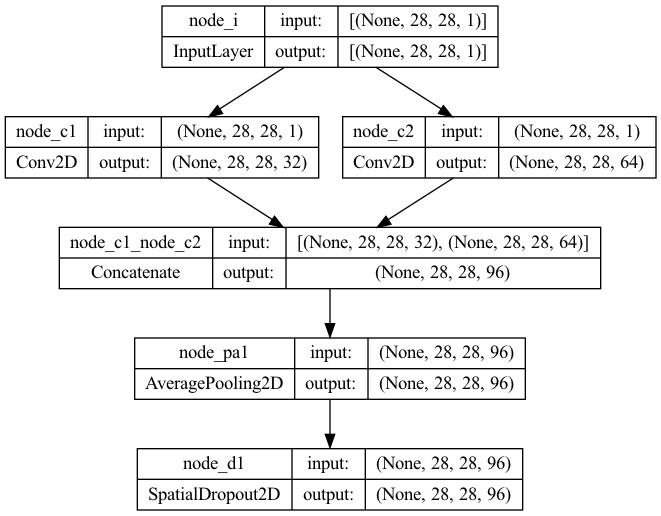

In [538]:
plot_model(model, show_shapes=True, show_layer_names=True)

In [641]:
data = StaticLinear('parameters.yaml')
data.generate_block_population()
pprint.pprint(data.population)

Retrieving yaml parameters...
__________________________________________________
{'individual_1': {'connections': {'connection_1': {'enabled': True,
                                                   'in': 'node_i',
                                                   'innovation': 1,
                                                   'out': 'node_o'}},
                  'meta_data': {'connection_list': [('node_i',
                                                     'node_o',
                                                     'connection_1')],
                                'connection_list_enabled': [True],
                                'n_connections': 1,
                                'n_convolution': 0,
                                'n_dropout': 0,
                                'n_enabled': 1,
                                'n_nodes': 2,
                                'n_pool': 0,
                                'node_list': ['node_i', 'node_o']},
                  'node

In [642]:
data.load_data()

Loading data for use case: MNIST...
__________________________________________________


In [643]:
for i in range(100):
    data.add_node(1)
    for ind in data.population:
        if len(data.population[ind]['nodes']['node_o']['connections_out']) > 0 or len(data.population[ind]['nodes']['node_i']['connections_in']) > 0:
            print('Ind: ', ind)
            print('After adding node')
            break

    data.add_connection(1)
    for ind in data.population:
        if len(data.population[ind]['nodes']['node_o']['connections_out']) > 0 or len(data.population[ind]['nodes']['node_i']['connections_in']) > 0:
            print('Ind: ', ind)
            print('After adding connection')
            break
    else:
        continue
    break

In [644]:
for i in range(2):
    data.switch_connection(1)
    for ind in data.population:
        if len(data.population[ind]['nodes']['node_o']['connections_out']) > 0 or len(data.population[ind]['nodes']['node_i']['connections_in']) > 0:
            print('Ind: ', ind)
            print('After switching connection')
            break
    else:
        continue
    break

In [645]:
parent_list = ['individual_1', 'individual_2']
offspring = data.crossover(parent_list, 1)
pprint.pprint(offspring)

{'connections': {'connection_1010': {'enabled': True,
                                     'in': 'node_pa16',
                                     'innovation': 1010,
                                     'out': 'node_c46'},
                 'connection_1019': {'enabled': True,
                                     'in': 'node_pm39',
                                     'innovation': 1019,
                                     'out': 'node_c131'},
                 'connection_1020': {'enabled': True,
                                     'in': 'node_c131',
                                     'innovation': 1020,
                                     'out': 'node_c12'},
                 'connection_1039': {'enabled': True,
                                     'in': 'node_pa25',
                                     'innovation': 1039,
                                     'out': 'node_c5'},
                 'connection_1048': {'enabled': True,
                                     'in': 'node_d

In [646]:
for individual in data.population:
    data.node_layers(data.population[individual], inputs = Input(shape = (28, 28, 1), name = 'node_i'))

In [647]:
pprint.pprint(data.population)

{'individual_1': {'connections': {'connection_1010': {'enabled': True,
                                                      'in': 'node_pa16',
                                                      'innovation': 1010,
                                                      'out': 'node_c46'},
                                  'connection_1019': {'enabled': True,
                                                      'in': 'node_pm39',
                                                      'innovation': 1019,
                                                      'out': 'node_c131'},
                                  'connection_1020': {'enabled': True,
                                                      'in': 'node_c131',
                                                      'innovation': 1020,
                                                      'out': 'node_c12'},
                                  'connection_1039': {'enabled': True,
                                                    

In [648]:
for individual in data.population:
    print('Individual: ', individual)
    data.build_block(data.population[individual], node = 'node_i', visited = [])

pprint.pprint(data.population)

Individual:  individual_1
Valid nodes:  ['node_i', 'node_d1', 'node_c5', 'node_pm2', 'node_c12', 'node_d14', 'node_c19', 'node_pa10', 'node_c29', 'node_d23', 'node_pa16', 'node_d30', 'node_c46', 'node_c52', 'node_d41', 'node_pa25', 'node_pa31', 'node_pa36', 'node_d52', 'node_c69', 'node_d59', 'node_d60', 'node_d65', 'node_d69', 'node_c88', 'node_d77', 'node_d81', 'node_c98', 'node_pm32', 'node_pa56', 'node_c104', 'node_pm39', 'node_c111', 'node_c116', 'node_d101', 'node_c125', 'node_pa68', 'node_c131', 'node_d113', 'node_pm53', 'node_c139', 'node_pa81', 'node_d126', 'node_c150', 'node_c152', 'node_pa88', 'node_d146', 'node_c162', 'node_pa91', 'node_d155', 'node_d159', 'node_pm69', 'node_pm73', 'node_pa104', 'node_c190', 'node_d172', 'node_c199', 'node_pa110', 'node_pm79', 'node_d188', 'node_pa120', 'node_c215', 'node_pa125', 'node_c220', 'node_pm89', 'node_pm91', 'node_d210', 'node_d213', 'node_d218', 'node_d222', 'node_pm99', 'node_c249', 'node_pm104', 'node_pa135', 'node_d235', 'node

Output exceeds the size limit. Open the full output data in a text editor
---------------------------------------------------------------------------
ValueError                                Traceback (most recent call last)
/Users/Donovan/Documents/Masters/masters-ed02/coding/model_cnn_ga_3/model_cnn_ga.ipynb Cell 12 in ()
      1 for individual in data.population:
      2     print('Individual: ', individual)
----> 3     data.build_block(data.population[individual], node = 'node_i', visited = [])
      5 pprint.pprint(data.population)

/Users/Donovan/Documents/Masters/masters-ed02/coding/model_cnn_ga_3/model_cnn_ga.ipynb Cell 12 in StaticLinear.build_block(self, individual, node, visited, valid_nodes)
   1051         individual['nodes'][neighbour]['layer'] = individual['nodes'][neighbour]['attributes']['layer_object'](individual['nodes'][node]['layer'])
   1053         # Recursively call the function to define the layers for the neighbouring node, i.e. depth first search while the neighbouring node has only one incoming connection
-> 1054         self.build_block(individual, neighbour, visited, valid_nodes)
   1056 # If the neighbouring node has more than one incoming connection
   1057 else:
   1058     
   1059     # Add the preceding node's layer to the neighbouring node's list of layers to concatenate
   1060     individual['nodes'][neighbour]['concat_list'].append(individual['nodes'][node]['layer'])

/Users/Donovan/Documents/Masters/masters-ed02/coding/model_cnn_ga_3/model_cnn_ga.ipynb Cell 12 in StaticLinear.build_block(self, individual, node, visited, valid_nodes)
   1051         individual['nodes'][neighbour]['layer'] = individual['nodes'][neighbour]['attributes']['layer_object'](individual['nodes'][node]['layer'])
   1053         # Recursively call the function to define the layers for the neighbouring node, i.e. depth first search while the neighbouring node has only one incoming connection
-> 1054         self.build_block(individual, neighbour, visited, valid_nodes)
   1056 # If the neighbouring node has more than one incoming connection
   1057 else:
   1058     
...

Depth of output (256) is not a multiple of the number of groups (36) for '{{node node_c1/Conv2D}} = Conv2D[T=DT_FLOAT, data_format="NHWC", dilations=[1, 1, 1, 1], explicit_paddings=[], padding="SAME", strides=[1, 1, 1, 1], use_cudnn_on_gpu=true](Placeholder, node_c1/Conv2D/ReadVariableOp)' with input shapes: [?,28,28,36], [1,1,1,256].

Call arguments received by layer "node_c1" (type Conv2D):
  • inputs=tf.Tensor(shape=(None, 28, 28, 36), dtype=float32)

In [ ]:
# inputs = block_individual_1['nodes']['node_i']['layer']
# outputs = block_individual_1['nodes']['node_o']['layer']

# # Create the model
# model = keras.Model(inputs=inputs, outputs=outputs, name="block_cnn")

# # Print the summary of the model
# model.summary()

# flatten = layers.Flatten()(layer_out)
# outputs = layers.Dense(10, activation="softmax")(flatten)

# # Create the model
# model = keras.Model(inputs=inputs, outputs=outputs, name="recursive_cnn")

# # Print the summary of the model
# model.summary()

In [650]:
print(data.population['individual_1']['nodes']['node_i']['layer'])
print(data.population['individual_1']['nodes']['node_o']['layer'])

KerasTensor(type_spec=TensorSpec(shape=(None, 28, 28, 1), dtype=tf.float32, name='node_i'), name='node_i', description="created by layer 'node_i'")
None


In [649]:
inputs = data.population['individual_1']['nodes']['node_i']['layer']

flatten = layers.Flatten()(data.population['individual_1']['nodes']['node_o']['layer'])
outputs = layers.Dense(10, activation="softmax")(flatten)



model = keras.Model(inputs = inputs, outputs = outputs, name = 'block_cnn')

TypeError: Inputs to a layer should be tensors. Got: None

In [ ]:
plot_model(model, show_shapes=True, show_layer_names=True)

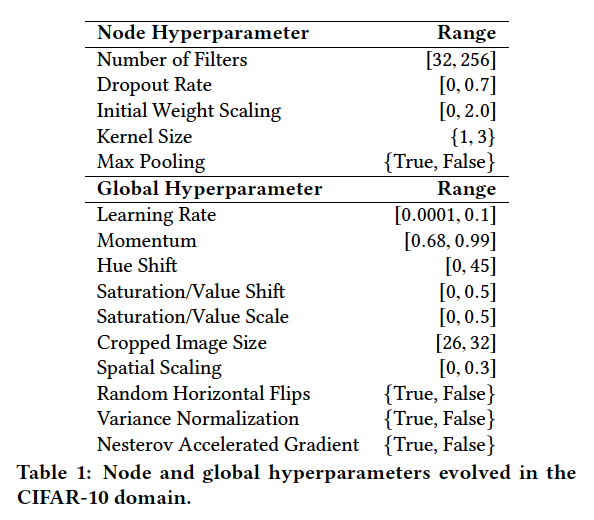

In [ ]:
population = {
    'individual_1':{
        'nodes':{
            'node_1':{
                'type':'input',
                'attributes':None
            },
            'node_2':{
                'type':'output',
                'attributes':None
            },
            'node_3':{
                'type':'convolution',
                'attributes':{
                    'n_filters':32,
                    'dropout':0.7,
                    'kernel_size':3
                }
            },
            'node_4':{
                'type':'pooling',
                'attributes':{
                    'type':'max',
                    'size':2, 
                    'padding':'same'
                }
            },
            'node_5':{
                'type':'convolution',
                'attributes':{
                    'n_filters':8,
                    'dropout':0.2,
                    'kernel_size':1
                }
            },
            'node_6':{
                'type':'dropout',
                'attributes':None
            },
            'node_7':{
                'type':'convolution',
                'attributes':{
                    'n_filters':128,
                    'dropout':0.5,
                    'kernel_size':3
                }
            }
        },
        'connections':{
            'connection_1':{
                'in':'node_1',
                'out':'node_2',
                'enabled':True,
                'innovation':1
            },
            'connection_2':{
                'in':'node_1',
                'out':'node_3',
                'enabled':True,
                'innovation':2
            },
            'connection_3':{
                'in':'node_1',
                'out':'node_2',
                'enabled':True,
                'innovation':3
            },
            'connection_4':{
                'in':'node_1',
                'out':'node_2',
                'enabled':True,
                'innovation':4
            },
            'connection_5':{
                'in':'node_1',
                'out':'node_2',
                'enabled':True,
                'innovation':5
            },
            'connection_6':{
                'in':'node_1',
                'out':'node_2',
                'enabled':True,
                'innovation':7
            },
            'connection_7':{
                'in':'node_1',
                'out':'node_2',
                'enabled':True,
                'innovation':9
            },
            'connection_8':{
                'in':'node_1',
                'out':'node_2',
                'enabled':True,
                'innovation':10
            },
            'connection_9':{
                'in':'node_1',
                'out':'node_2',
                'enabled':True,
                'innovation':11
            },
            'connection_10':{
                'in':'node_1',
                'out':'node_2',
                'enabled':True,
                'innovation':12
            }
        },
        'scores':{
            'fitness':10,
            'diversity_1':None,
            'diversity_2':None
        },
        'meta_data':{
            'n_nodes':7,
            'n_connections':10,
            'n_enabled':10,
            'n_convolution':3,
            'n_pool':1,
            'n_dropout':1
        }
    }
}

In [ ]:
population = {
    'ind_1':{
        'inno_num': 1,
        'from_node':1,
        'to_node':2,
        'type':'convolution',
        'attr':{
            'n_filters':32,
            'dropout':0.7,
            'kernel_size':3
        }
    },
    'ind_2':{
        'inno_num': 1,
        'from_node':1,
        'to_node':2,
        'type':'pool',
        'attr':{
            'type':'max', # average
            'size':2, #[2, 3, 4, 5]
            'padding':'same' # valid
        }
    }
}

Two possible mutations:
* New node
    * Connection is split
    * New innovation number assigned to each new connection formed by adding a new node
* New connection
    * Joins two existing nodes
    * New innovation number assigned for the single connection formed
* In both cases, if the structural mutation is unique then the innovation number is incremented by 1, else, the innovation number is inherited from the connection that exists in other individuals in the population
* In the case where the the nodes are layers of a CNN the innovation might be based on node as well as type.
    * For example: A connection

* A convolutional layer can always be followed by a dropout layer since a dropout layer with a dropout rate of zero is the same as no dropout layer. Pooling layers are likely to always follow convolutional layers (after dropout). Question is, can multiple convolutional layers feed into a pooling layer. In other words can concatenated convolutional layer outputs lead into a single pooling layer?

In [118]:
data.population['individual_1']['connections']

{'connection_1': {'in': 'node_1',
  'out': 'node_3',
  'enabled': True,
  'innovation': 1},
 'connection_2': {'in': 'node_3',
  'out': 'node_2',
  'enabled': True,
  'innovation': 1}}

In [120]:
[data.population['individual_1']['connections'][x]['in'] for x in data.population['individual_1']['connections']]

['node_1', 'node_3']

[x['in'] for x in data.population[individual_id]['connections']]